In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [65]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')


In [4]:
!pip install -q ipympl

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.6/511.6 kB 23.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 68.9 MB/s eta 0:00:00


In [5]:
%matplotlib widget
from google.colab import output
output.enable_custom_widget_manager()

# Data Overview

In [6]:
data = pd.read_csv('/content/drive/MyDrive/IEOR4574:Project_2/LD2011_2014.txt', index_col=0, sep=';', decimal=',')
data.index = pd.to_datetime(data.index)
data.sort_index(inplace=True)

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 140256 entries, 2011-01-01 00:15:00 to 2015-01-01 00:00:00
Columns: 370 entries, MT_001 to MT_370
dtypes: float64(370)
memory usage: 397.0 MB


In [8]:
data

,MT_001,MT_002,MT_003,MT_004,MT_005,MT_006,MT_007,MT_008,MT_009,MT_010,...,MT_361,MT_362,MT_363,MT_364,MT_365,MT_366,MT_367,MT_368,MT_369,MT_370
2011-01-01 00:15:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2011-01-01 00:30:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2011-01-01 00:45:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2011-01-01 01:00:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2011-01-01 01:15:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-31 23:00:00,2.538071,22.048364,1.737619,150.406504,85.365854,303.571429,11.305822,282.828283,68.181818,72.043011,...,276.945039,28200.0,1616.033755,1363.636364,29.986962,5.851375,697.102722,176.961603,651.026393,7621.621622
2014-12-31 23:15:00,2.538071,21.337127,1.737619,166.666667,81.707317,324.404762,11.305822,252.525253,64.685315,72.043011,...,279.800143,28300.0,1569.620253,1340.909091,29.986962,9.947338,671.641791,168.614357,669.354839,6702.702703
2014-12-31 23:30:00,2.538071,20.625889,1.737619,162.601626,82.926829,318.452381,10.175240,242.424242,61.188811,74.193548,...,284.796574,27800.0,1556.962025,1318.181818,27.379400,9.362200,670.763828,153.589316,670.087977,6864.864865
2014-12-31 23:45:00,1.269036,21.337127,1.737619,166.666667,85.365854,285.714286,10.175240,225.589226,64.685315,72.043011,...,246.252677,28000.0,1443.037975,909.090909,26.075619,4.095963,664.618086,146.911519,646.627566,6540.540541


# Data Diagnostics

Check if there is no **missing values**.

In [9]:
data.isnull().values.any()

False

Check Values recored in **each 15 min**

In [10]:
data.index

DatetimeIndex(['2011-01-01 00:15:00', '2011-01-01 00:30:00',
               '2011-01-01 00:45:00', '2011-01-01 01:00:00',
               '2011-01-01 01:15:00', '2011-01-01 01:30:00',
               '2011-01-01 01:45:00', '2011-01-01 02:00:00',
               '2011-01-01 02:15:00', '2011-01-01 02:30:00',
               ...
               '2014-12-31 21:45:00', '2014-12-31 22:00:00',
               '2014-12-31 22:15:00', '2014-12-31 22:30:00',
               '2014-12-31 22:45:00', '2014-12-31 23:00:00',
               '2014-12-31 23:15:00', '2014-12-31 23:30:00',
               '2014-12-31 23:45:00', '2015-01-01 00:00:00'],
              dtype='datetime64[ns]', length=140256, freq=None)

In [11]:
from datetime import datetime
j = "2011-01-01 00:15:00"
j = datetime.strptime(j,'%Y-%m-%d %H:%M:%S')
diff = []
for i in data.index:
    if i == j:
        continue
    else:
        diff.append(i - j)
        j = i

In [12]:
all(element == diff[0] for element in diff)

True

Every year in **March** time change day (which has only 23 hours) the **values between 1:00 am and 2:00 am are zero for all points**.


In [13]:
data[(data.T == 0).all()]

,MT_001,MT_002,MT_003,MT_004,MT_005,MT_006,MT_007,MT_008,MT_009,MT_010,...,MT_361,MT_362,MT_363,MT_364,MT_365,MT_366,MT_367,MT_368,MT_369,MT_370


In [14]:
#March 13, 2011
(data.loc['2011-03-13'].sum(axis = 1)==0.0).any()

False

In [15]:
date = []
for index, row in data.iterrows():
    if row.sum() == 0.0:
        date.append(index)
date

[]

The argument above is invalid!!! There is **no rows** whose entries are **all zeros**.

Every year in **October** time change day (which has 25 hours) the values** between 1:00 am and 2:00 am** **aggregate** the consumption of two hours.

In [16]:
# November 6, 2011
data.loc['2011-11-06 00:00:00' :'2011-11-06 03:00:00'].sum(axis = 1).sum()

917667.7865231483

In [17]:
data.loc['2011-11-05 00:00:00' : '2011-11-05 03:00:00'].sum(axis = 1).sum()

911724.5236558833

In [18]:
#comparison between different time slot on Nov. 6th 2011
a = []
for i in range(1,23):
    if i < 9:
        a.append(data.loc['2011-11-06 0'+str(i)+ ':00:00' :'2011-11-06 0'+str(i+1)+ ':00:00' ].sum(axis = 1).sum())
    elif i ==9:
        a.append(data.loc['2011-11-06 0'+str(i)+ ':00:00' :'2011-11-06 10:00:00' ].sum(axis = 1).sum())
    else:
         a.append(data.loc['2011-11-06 '+str(i)+ ':00:00' :'2011-11-06 '+str(i+1)+ ':00:00' ].sum(axis = 1).sum())

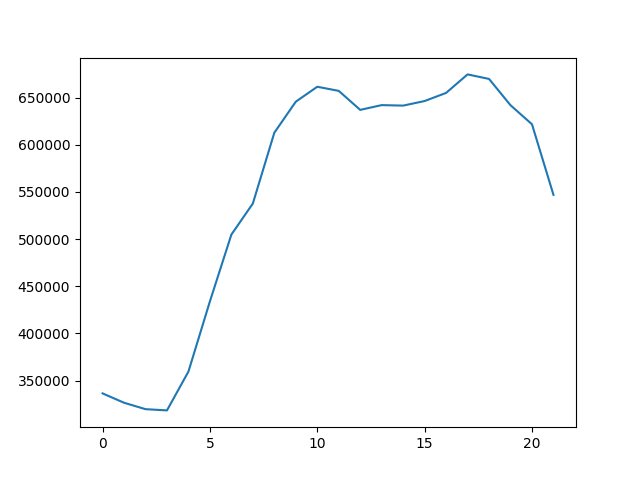

In [19]:
plt.plot(a)

In [20]:
#comparison between the same periods on different days
a = []
for i in range(1,31):
    if i < 10:
        a.append(data.loc['2011-11-0'+str(i)+ ' 01:00:00' :'2011-11-0' +str(i)+' 02:00:00'].sum(axis = 1).sum())
    else:
        a.append(data.loc['2011-11-'+str(i)+ ' 01:00:00' :'2011-11-' +str(i)+' 02:00:00'].sum(axis = 1).sum())

In [21]:
plt.plot(a)

In [22]:
#comparison between same time span on the same date of different months
a = []
for i in range(1,13):
    if i < 10:
        a.append(data.loc['2011-0' +str(i)+ '-06 01:00:00' :'2011-0' +str(i)+ '-06 02:00:00'].sum(axis = 1).sum())
    else:
        a.append(data.loc['2011-' +str(i)+ '-06 01:00:00' :'2011-' +str(i)+ '-06 02:00:00'].sum(axis = 1).sum())

In [23]:
plt.plot(a)

No proof of previous statement!

Check if there is **negative values**

In [24]:
(data < 0).values.any()

False

In [25]:
(data.values < 0.0).any()

False

Each column represent one client. Some clients were created after 2011. In these cases consumption were considered zero.

For each customer, how many consecutive days are there that they have electricity consumption of 0?

In [26]:
def len_consec_zeros(a):
    a = np.array(list(a))    # convert elements to `str`
    rr = np.argwhere(a == '0').ravel()  # find out positions of `0`
    if not rr.size:  # if there are no zeros, return 0
        return 0

    full = np.arange(rr[0], rr[-1]+1)  # get the range of spread of 0s

    # get the indices where `0` was flipped to something else
    diff = np.setdiff1d(full, rr)
    if not diff.size:     # if there are no bit flips, return the
        return len(full)  # size of the full range

    # break the array into pieces wherever there's a bit flip
    # and the result is the size of the largest chunk
    pos, difs = full[0], []
    for el in diff:
        difs.append(el - pos)
        pos = el + 1

    difs.append(full[-1]+1 - pos)

    # return size of the largest chunk
    res = max(difs) if max(difs) != 1 else 0

    return res

In [27]:
a = data.resample('D').sum()

In [28]:
a

,MT_001,MT_002,MT_003,MT_004,MT_005,MT_006,MT_007,MT_008,MT_009,MT_010,...,MT_361,MT_362,MT_363,MT_364,MT_365,MT_366,MT_367,MT_368,MT_369,MT_370
2011-01-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-03,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-28,227.157360,2131.578947,151.172893,14327.235772,6776.829268,20122.023810,429.621255,25255.892256,5118.881119,4794.623656,...,28815.132049,3272100.0,220721.518987,257477.272727,8169.491525,552.369807,45914.837577,4405.676127,66135.630499,1.553189e+06
2014-12-29,248.730964,2212.660028,160.729800,14067.073171,7198.780488,22824.404762,550.593556,30286.195286,6697.552448,6337.634409,...,28825.124911,3109100.0,206852.320675,269090.909091,8438.070404,1153.891164,53928.884987,12914.858097,73882.697947,1.806486e+06
2014-12-30,232.233503,2205.547653,165.073849,14290.650407,7189.024390,23880.952381,586.772188,30909.090909,6487.762238,6489.247312,...,28488.222698,2904300.0,204126.582278,263613.636364,10615.384615,892.334699,56334.503951,15996.661102,73950.146628,1.867568e+06
2014-12-31,229.695431,2273.115220,166.811468,14006.097561,7023.170732,23511.904762,690.785755,28700.336700,6211.538462,5034.408602,...,26970.735189,2748800.0,162556.962025,215886.363636,7415.906128,530.134582,50259.877085,13245.409015,70416.422287,1.365892e+06


In [29]:
a = a.loc["2012-01-01":]

In [30]:
a

,MT_001,MT_002,MT_003,MT_004,MT_005,MT_006,MT_007,MT_008,MT_009,MT_010,...,MT_361,MT_362,MT_363,MT_364,MT_365,MT_366,MT_367,MT_368,MT_369,MT_370
2012-01-01,711.928934,2497.866287,1999.131190,11384.146341,5489.024390,24681.547619,539.853024,22134.680135,5755.244755,6296.774194,...,25757.316203,2805700.0,199248.945148,202090.909091,1715.775750,988.882387,41165.935031,4906.510851,66076.246334,0.000000e+00
2012-01-02,1025.380711,2576.102418,478.714162,12288.617886,6213.414634,23383.928571,396.269079,28205.387205,8386.363636,5556.989247,...,30738.044254,3494400.0,241362.869198,244772.727273,7487.614081,2253.364541,54552.238806,14155.258765,77304.252199,0.000000e+00
2012-01-03,1040.609137,2876.244666,774.978280,11804.878049,6456.097561,22407.738095,364.612776,28057.239057,7797.202797,8168.817204,...,24010.706638,3445000.0,230544.303797,274727.272727,7830.508475,2638.970158,55534.679543,15612.687813,80332.111437,0.000000e+00
2012-01-04,1093.908629,2509.957326,1369.244136,11697.154472,6652.439024,22794.642857,371.961560,27326.599327,7779.720280,7080.645161,...,28746.609565,3421000.0,246658.227848,273727.272727,7508.474576,2186.073727,53230.026339,14357.262104,76630.498534,0.000000e+00
2012-01-05,1351.522843,2640.825036,3965.247611,11693.089431,6384.146341,21208.333333,331.260599,26390.572391,7865.384615,7720.430108,...,26391.149179,3478600.0,233877.637131,260386.363636,7352.020860,2458.747806,56450.395083,18784.641068,79843.108504,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-28,227.157360,2131.578947,151.172893,14327.235772,6776.829268,20122.023810,429.621255,25255.892256,5118.881119,4794.623656,...,28815.132049,3272100.0,220721.518987,257477.272727,8169.491525,552.369807,45914.837577,4405.676127,66135.630499,1.553189e+06
2014-12-29,248.730964,2212.660028,160.729800,14067.073171,7198.780488,22824.404762,550.593556,30286.195286,6697.552448,6337.634409,...,28825.124911,3109100.0,206852.320675,269090.909091,8438.070404,1153.891164,53928.884987,12914.858097,73882.697947,1.806486e+06
2014-12-30,232.233503,2205.547653,165.073849,14290.650407,7189.024390,23880.952381,586.772188,30909.090909,6487.762238,6489.247312,...,28488.222698,2904300.0,204126.582278,263613.636364,10615.384615,892.334699,56334.503951,15996.661102,73950.146628,1.867568e+06
2014-12-31,229.695431,2273.115220,166.811468,14006.097561,7023.170732,23511.904762,690.785755,28700.336700,6211.538462,5034.408602,...,26970.735189,2748800.0,162556.962025,215886.363636,7415.906128,530.134582,50259.877085,13245.409015,70416.422287,1.365892e+06


In [31]:
consecutive_zeros = []
for i in a.columns:
    consecutive_zeros.append(len_consec_zeros(a.loc[:, i]))

In [32]:
plt.plot(consecutive_zeros)

In [33]:
all(element == consecutive_zeros[0] for element in consecutive_zeros)

True

In [34]:
data_transposed = data.T

In [35]:
data_transposed

,2011-01-01 00:15:00,2011-01-01 00:30:00,2011-01-01 00:45:00,2011-01-01 01:00:00,2011-01-01 01:15:00,2011-01-01 01:30:00,2011-01-01 01:45:00,2011-01-01 02:00:00,2011-01-01 02:15:00,2011-01-01 02:30:00,...,2014-12-31 21:45:00,2014-12-31 22:00:00,2014-12-31 22:15:00,2014-12-31 22:30:00,2014-12-31 22:45:00,2014-12-31 23:00:00,2014-12-31 23:15:00,2014-12-31 23:30:00,2014-12-31 23:45:00,2015-01-01 00:00:00
MT_001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.538071,1.269036,2.538071,2.538071,1.269036,2.538071,2.538071,2.538071,1.269036,2.538071
MT_002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,22.048364,22.048364,22.048364,22.048364,22.048364,22.048364,21.337127,20.625889,21.337127,19.914651
MT_003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.737619,1.737619,1.737619,1.737619,1.737619,1.737619,1.737619,1.737619,1.737619,1.737619
MT_004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,156.504065,164.634146,160.569106,162.601626,156.504065,150.406504,166.666667,162.601626,166.666667,178.861789
MT_005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,86.585366,93.902439,87.804878,80.487805,85.365854,85.365854,81.707317,82.926829,85.365854,84.146341
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT_366,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.510825,6.436513,11.702750,8.191925,4.681100,5.851375,9.947338,9.362200,4.095963,4.095963
MT_367,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,546.971027,521.510097,672.519754,719.051800,707.638279,697.102722,671.641791,670.763828,664.618086,628.621598
MT_368,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,185.308848,173.622705,213.689482,205.342237,188.647746,176.961603,168.614357,153.589316,146.911519,131.886477
MT_369,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,653.958944,658.357771,711.876833,694.281525,652.492669,651.026393,669.354839,670.087977,646.627566,673.020528


In [35]:
data_transposed.index

Index(['MT_001', 'MT_002', 'MT_003', 'MT_004', 'MT_005', 'MT_006', 'MT_007',
       'MT_008', 'MT_009', 'MT_010',
       ...
       'MT_361', 'MT_362', 'MT_363', 'MT_364', 'MT_365', 'MT_366', 'MT_367',
       'MT_368', 'MT_369', 'MT_370'],
      dtype='object', length=370)

# Data Preprocessing AKA ***clustering***

In [ ]:
#standardization?
#data_prime = (data - data.mean())/(data.std())

In [ ]:
#data_prime.head()

,MT_001,MT_002,MT_003,MT_004,MT_005,MT_006,MT_007,MT_008,MT_009,MT_010,...,MT_361,MT_362,MT_363,MT_364,MT_365,MT_366,MT_367,MT_368,MT_369,MT_370
2011-01-01 00:15:00,-0.663571,-1.564785,-0.264953,-1.410931,-1.407348,-1.434655,-0.697126,-1.569107,-1.340798,-1.26358,...,-1.065322,-0.971985,-1.047706,-1.076047,-1.006235,-0.925418,-1.546502,-1.179426,-1.642564,-0.948582
2011-01-01 00:30:00,-0.663571,-1.564785,-0.264953,-1.410931,-1.407348,-1.434655,-0.697126,-1.569107,-1.340798,-1.26358,...,-1.065322,-0.971985,-1.047706,-1.076047,-1.006235,-0.925418,-1.546502,-1.179426,-1.642564,-0.948582
2011-01-01 00:45:00,-0.663571,-1.564785,-0.264953,-1.410931,-1.407348,-1.434655,-0.697126,-1.569107,-1.340798,-1.26358,...,-1.065322,-0.971985,-1.047706,-1.076047,-1.006235,-0.925418,-1.546502,-1.179426,-1.642564,-0.948582
2011-01-01 01:00:00,-0.663571,-1.564785,-0.264953,-1.410931,-1.407348,-1.434655,-0.697126,-1.569107,-1.340798,-1.26358,...,-1.065322,-0.971985,-1.047706,-1.076047,-1.006235,-0.925418,-1.546502,-1.179426,-1.642564,-0.948582
2011-01-01 01:15:00,-0.663571,-1.564785,-0.264953,-1.410931,-1.407348,-1.434655,-0.697126,-1.569107,-1.340798,-1.26358,...,-1.065322,-0.971985,-1.047706,-1.076047,-1.006235,-0.925418,-1.546502,-1.179426,-1.642564,-0.948582


## *original data*

In [ ]:
#Pearson correlation coefficient
corr_mat = data.corr(method='pearson')

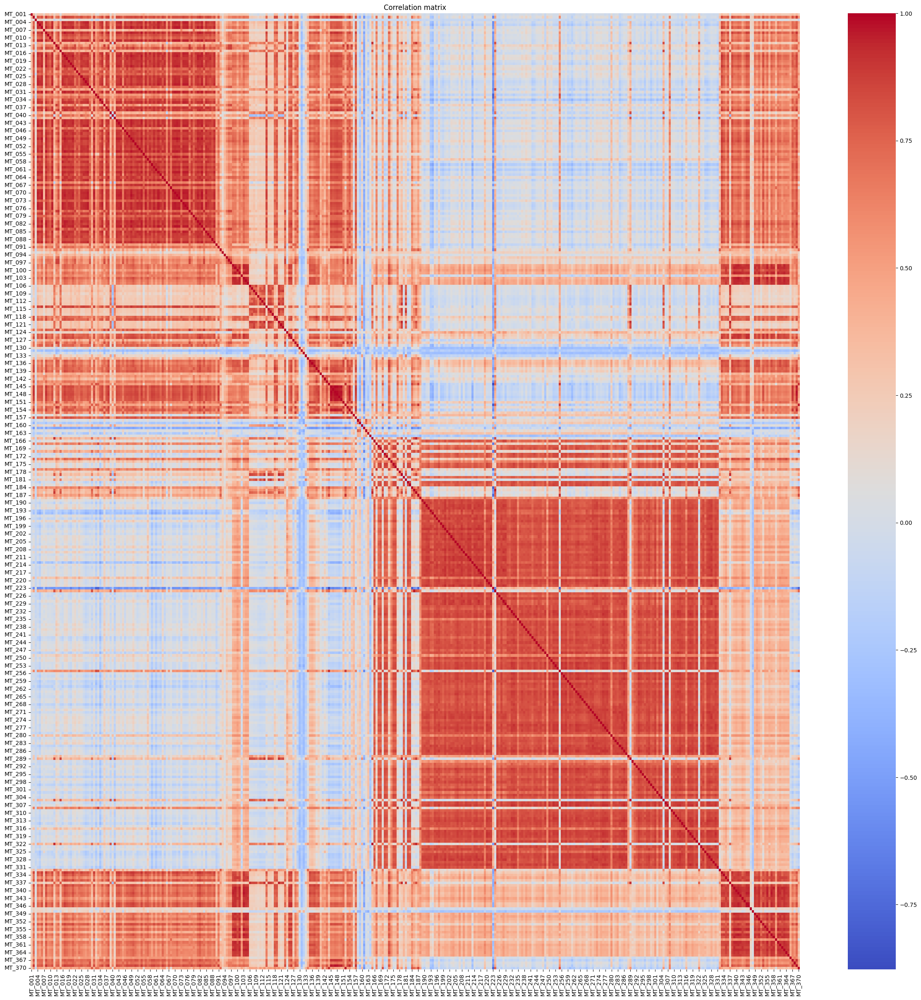

In [ ]:
import seaborn as sns
fig, ax1 = plt.subplots(figsize=(30,30))
sns.heatmap(corr_mat,ax= ax1, cmap='coolwarm');
ax1.title.set_text('Correlation matrix')
plt.show()

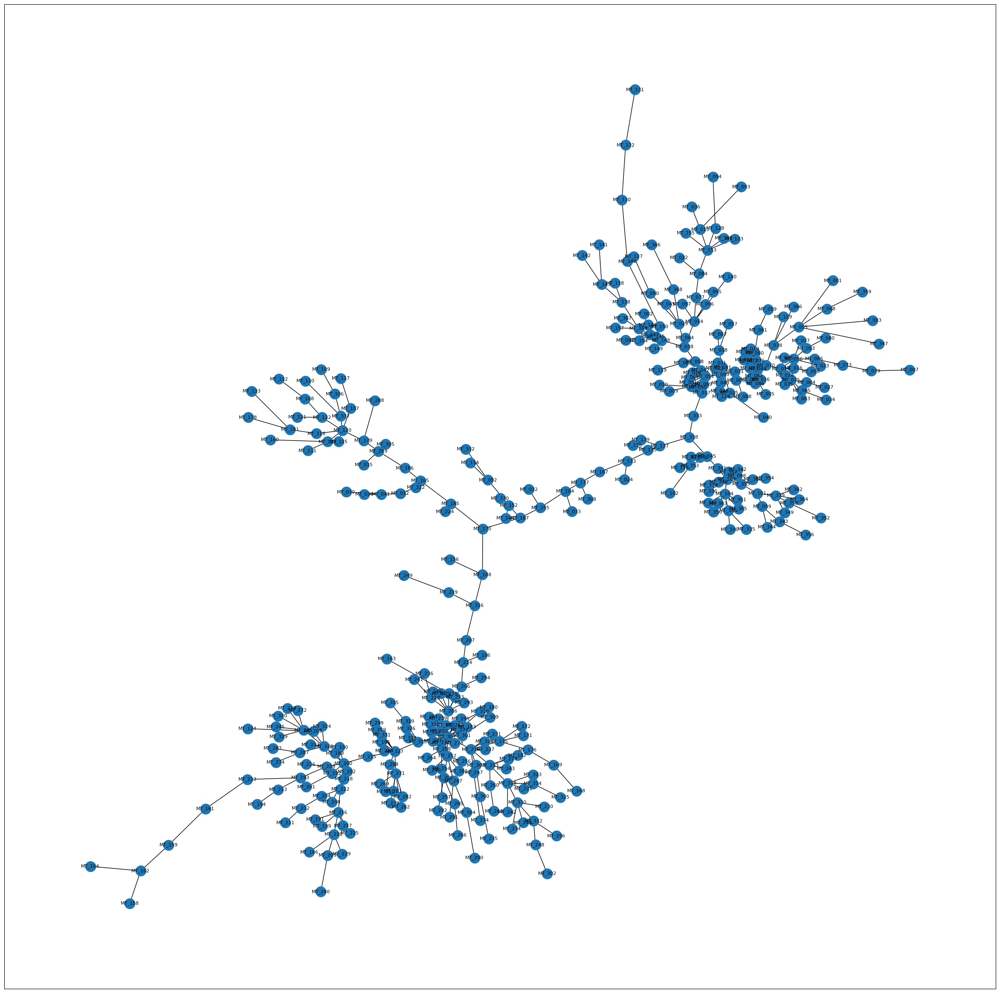

In [ ]:
#Correlation-based distance & Mimimum spanning tree
import networkx as nx
dist = np.sqrt(0.5*(1-corr_mat))
G = nx.Graph(dist.to_numpy())
labels = dist.columns.values
G = nx.relabel_nodes(G, dict(zip(range(len(labels)),labels)))
T = nx.minimum_spanning_tree(G)

fig = plt.figure(figsize = (30,30))
nx.draw_networkx(T,
                 with_labels=True,
                 font_size = 8,
                 cmap = plt.cm.coolwarm,
                 pos = nx.kamada_kawai_layout(T),vmin = 0, vmax=1
                 )
plt.show()


In [ ]:
#Linkage matrix
import scipy.cluster.hierarchy as sch
link = sch.linkage(dist, 'average')

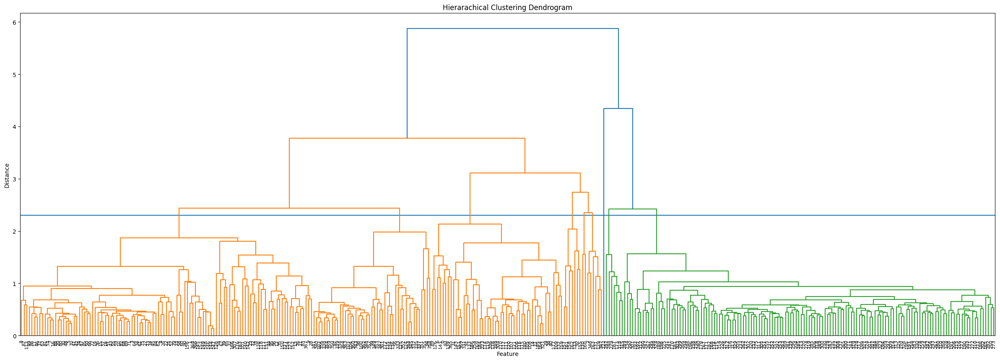

In [ ]:
#Plot dendrogram
fig = plt.figure(figsize=(30,10))
plt.title('Hierarachical Clustering Dendrogram')
plt.xlabel('Feature')
plt.ylabel('Distance')
plt.hlines(2.3,0, 19800)
dn = sch.dendrogram(link, leaf_rotation = 90., leaf_font_size=8.)
plt.show()

In [ ]:
from scipy.cluster.hierarchy import fcluster
max_d = 2.3
clusters = fcluster(link,t=max_d,criterion = 'distance')
df_clust = pd.DataFrame({'Cluster': clusters, 'Features':data.columns.values.astype('str')})
df_clust

,Cluster,Features
0,3,MT_001
1,1,MT_002
2,6,MT_003
3,1,MT_004
4,1,MT_005
...,...,...
365,3,MT_366
366,1,MT_367
367,1,MT_368
368,1,MT_369


In [ ]:
df_clust.groupby('Cluster').count()

,Features
Cluster,
1,111
2,45
3,50
4,7
5,2
6,6
7,7
8,141
9,1


In [ ]:
df_clust[(df_clust.Cluster == 9)]

,Cluster,Features
222,9,MT_223


In [ ]:
df_clust[(df_clust.Cluster == 5)]

,Cluster,Features
130,5,MT_131
160,5,MT_161


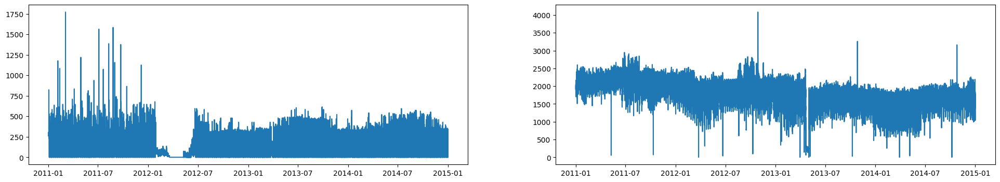

In [ ]:
fig,(ax1, ax2) = plt.subplots(ncols=2, figsize=(24,4))
ax1.plot(data.MT_131)
ax2.plot(data.MT_161)

In [ ]:
df_clust[(df_clust.Cluster == 6)]

,Cluster,Features
2,6,MT_003
129,6,MT_130
131,6,MT_132
163,6,MT_164
346,6,MT_347
347,6,MT_348


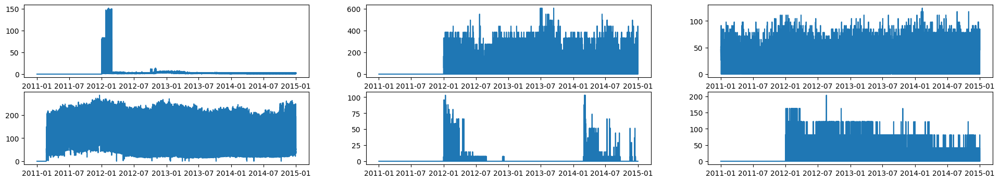

In [ ]:
fig,[[ax1, ax2, ax3], [ax4, ax5, ax6]] = plt.subplots(nrows = 2, ncols=3, figsize=(24,4))
ax1.plot(data.MT_003)
ax2.plot(data.MT_130)
ax3.plot(data.MT_132)
ax4.plot(data.MT_164)
ax5.plot(data.MT_347)
ax6.plot(data.MT_348)

## Experiment on Gap Statistic to obtain optimal number of clusters(to be continued)

In [ ]:

#Gap statistic method for selecting optimal # of clusters

# def optimal_cluster(data,nrefs = 3, maxClusters = 20):
#     gaps = np.zeros((len(range(1,maxClusters)),))
#     resultsdf=pd.DataFrame({'clusterCount':[],'gap':[]})
#     for gap_index, k in enumerate(range(1,maxClusters)):
#         refDisps = np.zeros(nrefs)
#         for i in range(nrefs):
#             randomReference = np.random.random_sample(size= data.shape)
!pip install gap-stat


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from gap_statistic import OptimalK
optimalK = OptimalK(n_jobs=4, parallel_backend='joblib')
n_clusters = optimalK(data, cluster_array=np.arange(1, 30))

In [ ]:
n_clusters

29

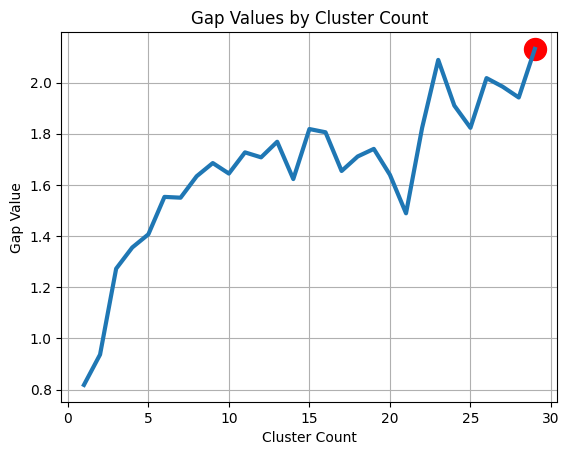

In [ ]:
plt.plot(optimalK.gap_df.n_clusters, optimalK.gap_df.gap_value, linewidth=3)
plt.scatter(optimalK.gap_df[optimalK.gap_df.n_clusters == n_clusters].n_clusters,
            optimalK.gap_df[optimalK.gap_df.n_clusters == n_clusters].gap_value, s=250, c='r')
plt.grid(True)
plt.xlabel('Cluster Count')
plt.ylabel('Gap Value')
plt.title('Gap Values by Cluster Count')
plt.show()

In [ ]:
from scipy.cluster.hierarchy import fcluster
max_d = 2
clusters = fcluster(link, t = max_d, criterion = 'distance')
df_clust = pd.DataFrame({'Cluster': clusters, 'Features': data.columns.values.astype('string')})
df_clust

In [ ]:
a = data.resample('D').sum()

In [ ]:
corr_mat1 = a.corr(method='pearson')

In [ ]:
optimalK1 = OptimalK(n_jobs=4, parallel_backend='joblib')
n_clusters1 = optimalK1(a, cluster_array=np.arange(1, 30))
n_clusters1

29

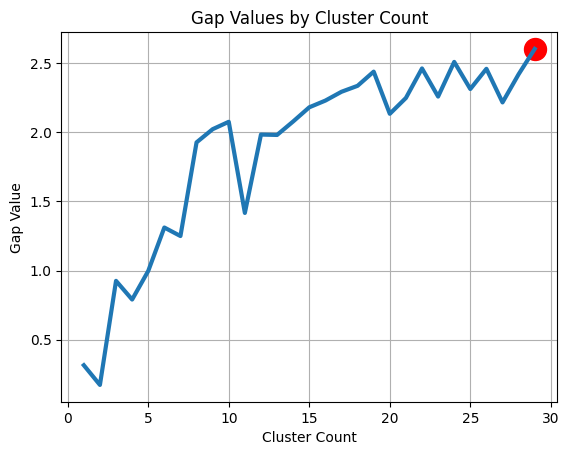

In [ ]:
plt.plot(optimalK1.gap_df.n_clusters, optimalK1.gap_df.gap_value, linewidth=3)
plt.scatter(optimalK1.gap_df[optimalK1.gap_df.n_clusters == n_clusters1].n_clusters,
            optimalK1.gap_df[optimalK1.gap_df.n_clusters == n_clusters1].gap_value, s=250, c='r')
plt.grid(True)
plt.xlabel('Cluster Count')
plt.ylabel('Gap Value')
plt.title('Gap Values by Cluster Count')
plt.show()

In [ ]:
b = (a - a.mean())/(a.std())

In [ ]:
optimalK2 = OptimalK(n_jobs=4, parallel_backend='joblib')
n_clusters2 = optimalK2(b, cluster_array=np.arange(1, 11))
n_clusters2

10

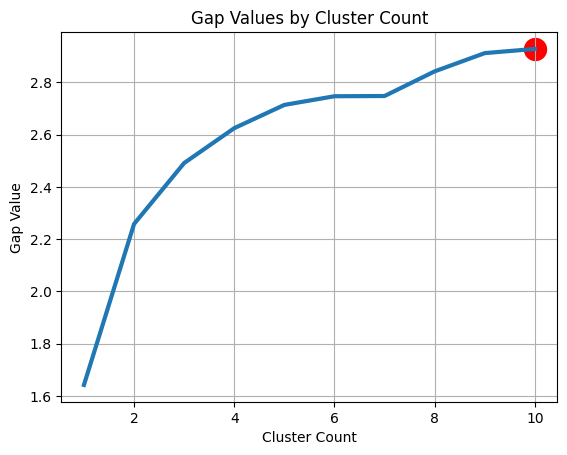

In [ ]:
plt.plot(optimalK2.gap_df.n_clusters, optimalK2.gap_df.gap_value, linewidth=3)
plt.scatter(optimalK2.gap_df[optimalK2.gap_df.n_clusters == n_clusters2].n_clusters,
            optimalK2.gap_df[optimalK2.gap_df.n_clusters == n_clusters2].gap_value, s=250, c='r')
plt.grid(True)
plt.xlabel('Cluster Count')
plt.ylabel('Gap Value')
plt.title('Gap Values by Cluster Count')
plt.show()

## *original data + standardization + outliers elimination*

In [ ]:
data_prime = (data - data.mean())/(data.std())

In [ ]:
outl_thresh = 0.999
outliers_mask =(data_prime > data_prime.quantile(outl_thresh)).any(axis = 1)
data_prime = data_prime[~outliers_mask]

In [ ]:
corr_mat_p = data_prime.corr(method ='pearson')
dist_p = np.sqrt(0.5*(1-corr_mat_p))

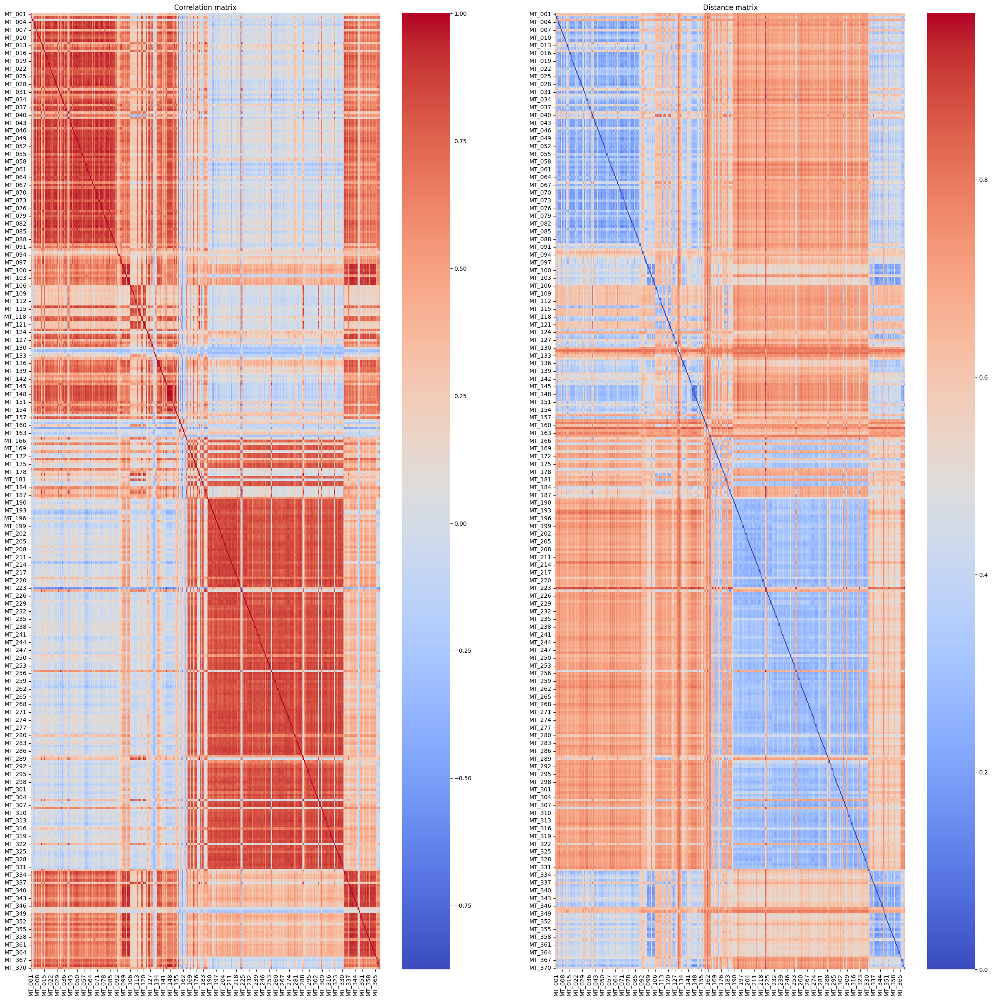

In [ ]:
fig,(ax1, ax2) = plt.subplots(ncols=2, figsize=(30,30))
sns.heatmap(corr_mat_p, ax = ax1, cmap='coolwarm');
sns.heatmap(dist_p, ax = ax2, cmap='coolwarm');
ax1.title.set_text('Correlation matrix')
ax2.title.set_text('Distance matrix')
plt.show()

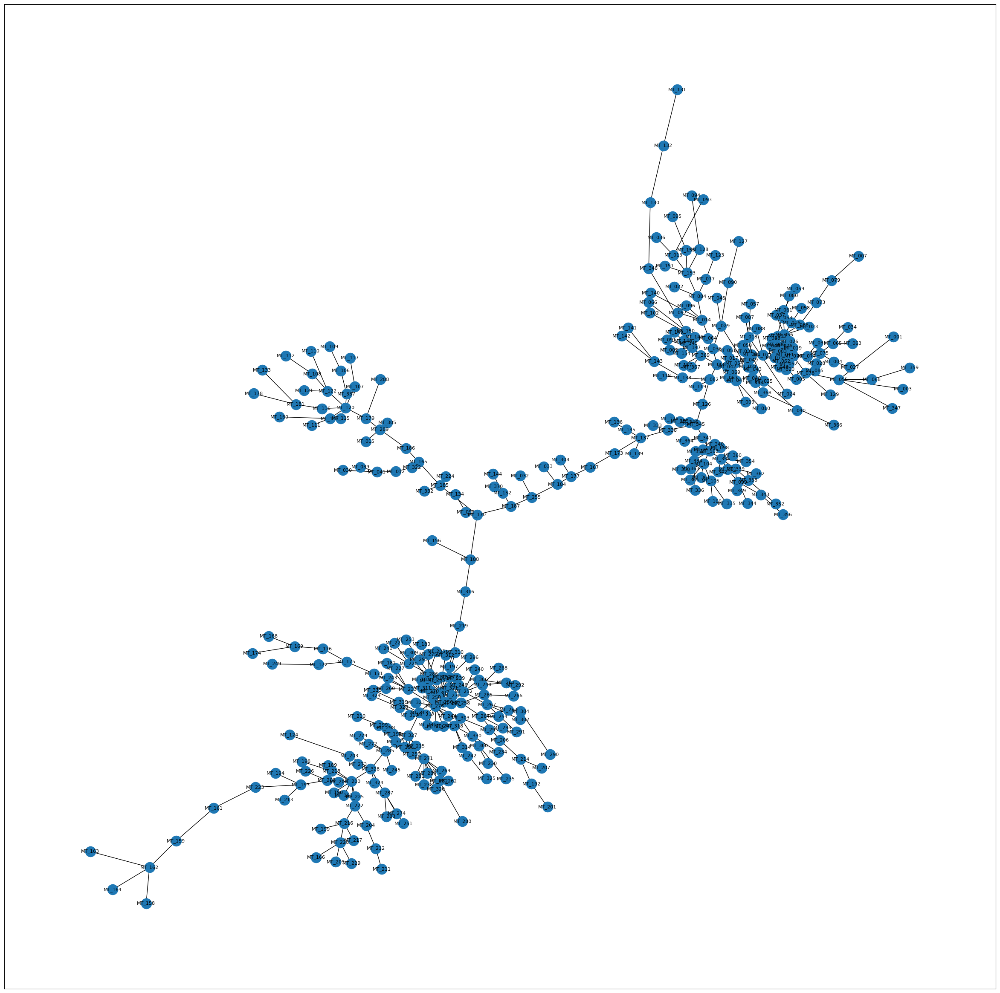

In [ ]:

G_p = nx.Graph(dist_p.to_numpy())
labels = dist_p.columns.values
G_p = nx.relabel_nodes(G_p, dict(zip(range(len(labels)),labels)))
T_p = nx.minimum_spanning_tree(G_p)

fig = plt.figure(figsize = (30,30))
nx.draw_networkx(T_p,
                 with_labels=True,
                 font_size = 8,
                 cmap = plt.cm.coolwarm,
                 pos = nx.kamada_kawai_layout(T_p),vmin = 0, vmax=1
                 )
plt.show()



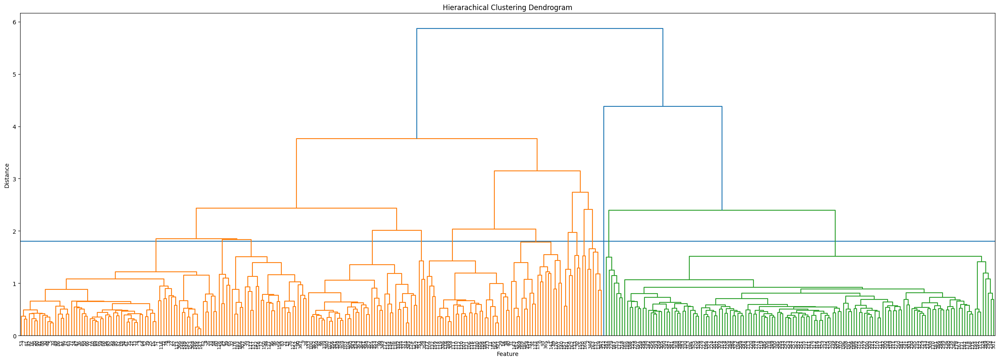

In [ ]:
link_p = sch.linkage(dist_p,'average')
fig = plt.figure(figsize=(30,10))
plt.title('Hierarachical Clustering Dendrogram')
plt.xlabel('Feature')
plt.ylabel('Distance')
plt.hlines(1.8,0, 19800)
dn_p = sch.dendrogram(link_p, leaf_rotation = 90., leaf_font_size=8.)
plt.show()

In [ ]:
max_d = 1.8
clusters_p = fcluster(link_p, t=max_d, criterion='distance')

In [ ]:
df_clust_p = pd.DataFrame({'Cluster':clusters_p, 'Feature':data_prime.columns.values.astype('str')})
df_clust_p.groupby('Cluster').count()

,Feature
Cluster,
1,75
2,5
3,29
4,42
5,3
6,32
7,20
8,4
9,3


In [ ]:
df_clust_p[(df_clust_p.Cluster == 14)]

,Cluster,Feature
222,14,MT_223


<Axes: >

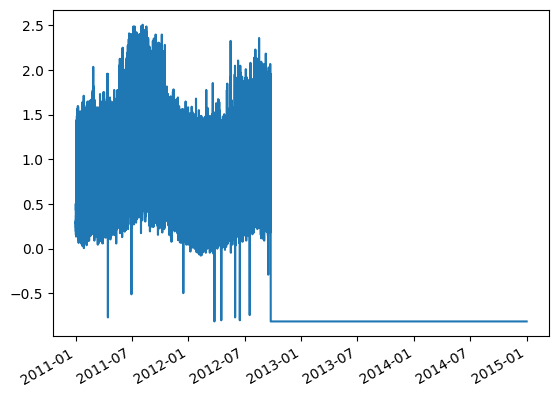

In [ ]:
data_prime.MT_223.plot()

In [ ]:
df_clust_p[(df_clust_p.Cluster == 10)]

,Cluster,Feature
130,10,MT_131
160,10,MT_161


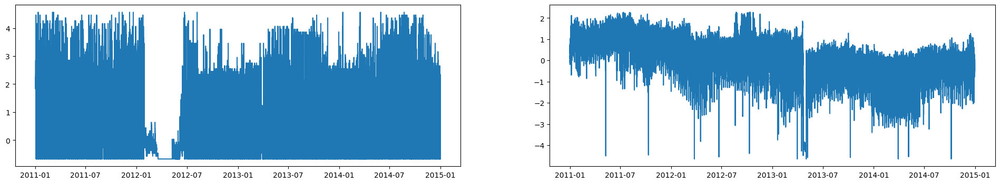

In [ ]:
fig,(ax1, ax2) = plt.subplots(ncols=2, figsize=(24,4))
ax1.plot(data_prime.MT_131)
ax2.plot(data_prime.MT_161)


In [ ]:
df_clust_p[(df_clust_p.Cluster == 9)]

,Cluster,Feature
92,9,MT_093
123,9,MT_124
155,9,MT_156


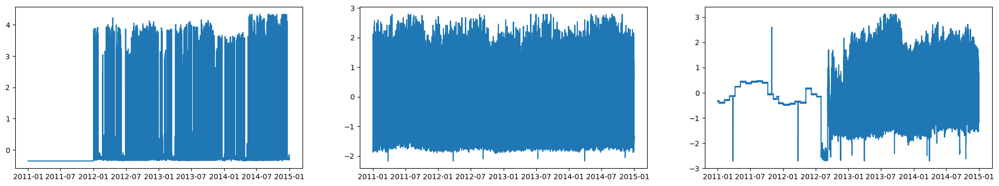

In [ ]:
fig,(ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(24,4))
ax1.plot(data_prime.MT_093)
ax2.plot(data_prime.MT_124)
ax3.plot(data_prime.MT_156)

In [ ]:
df_clust_p[(df_clust_p.Cluster == 5)]

,Cluster,Feature
94,5,MT_095
351,5,MT_352
358,5,MT_359


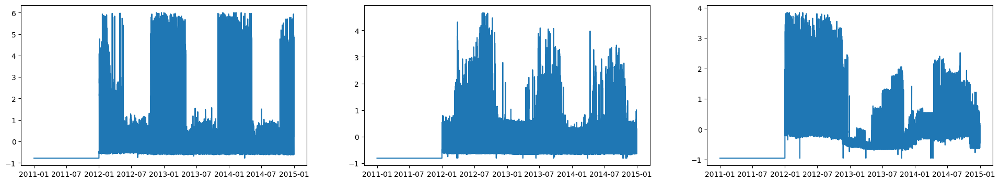

In [ ]:
fig,(ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(24,4))
ax1.plot(data_prime.MT_095)
ax2.plot(data_prime.MT_352)
ax3.plot(data_prime.MT_359)

In [ ]:
df_clust_p[(df_clust_p.Cluster == 8)]

,Cluster,Feature
157,8,MT_158
158,8,MT_159
161,8,MT_162
162,8,MT_163


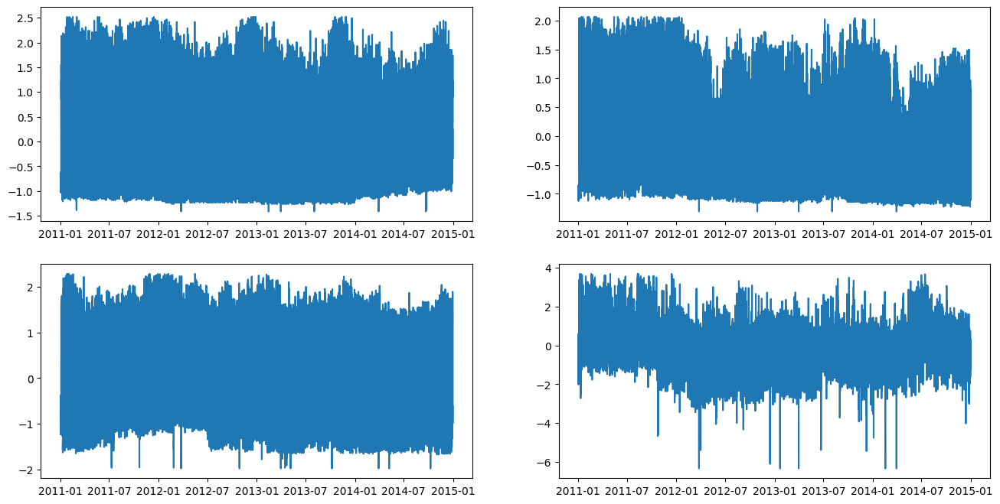

In [ ]:
fig,[[ax1, ax2], [ax3, ax4]] = plt.subplots(nrows= 2, ncols=2,figsize =(16,8))
ax1.plot(data_prime.MT_158)
ax2.plot(data_prime.MT_159)
ax3.plot(data_prime.MT_162)
ax4.plot(data_prime.MT_163)

## **daily data aggregation**

In [36]:
a = data.resample('D').sum()
a

,MT_001,MT_002,MT_003,MT_004,MT_005,MT_006,MT_007,MT_008,MT_009,MT_010,...,MT_361,MT_362,MT_363,MT_364,MT_365,MT_366,MT_367,MT_368,MT_369,MT_370
2011-01-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-03,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-28,227.157360,2131.578947,151.172893,14327.235772,6776.829268,20122.023810,429.621255,25255.892256,5118.881119,4794.623656,...,28815.132049,3272100.0,220721.518987,257477.272727,8169.491525,552.369807,45914.837577,4405.676127,66135.630499,1.553189e+06
2014-12-29,248.730964,2212.660028,160.729800,14067.073171,7198.780488,22824.404762,550.593556,30286.195286,6697.552448,6337.634409,...,28825.124911,3109100.0,206852.320675,269090.909091,8438.070404,1153.891164,53928.884987,12914.858097,73882.697947,1.806486e+06
2014-12-30,232.233503,2205.547653,165.073849,14290.650407,7189.024390,23880.952381,586.772188,30909.090909,6487.762238,6489.247312,...,28488.222698,2904300.0,204126.582278,263613.636364,10615.384615,892.334699,56334.503951,15996.661102,73950.146628,1.867568e+06
2014-12-31,229.695431,2273.115220,166.811468,14006.097561,7023.170732,23511.904762,690.785755,28700.336700,6211.538462,5034.408602,...,26970.735189,2748800.0,162556.962025,215886.363636,7415.906128,530.134582,50259.877085,13245.409015,70416.422287,1.365892e+06


In [37]:
corr_mat_a = a.corr(method='pearson')
dist_a = np.sqrt(0.5*(1-corr_mat_a))

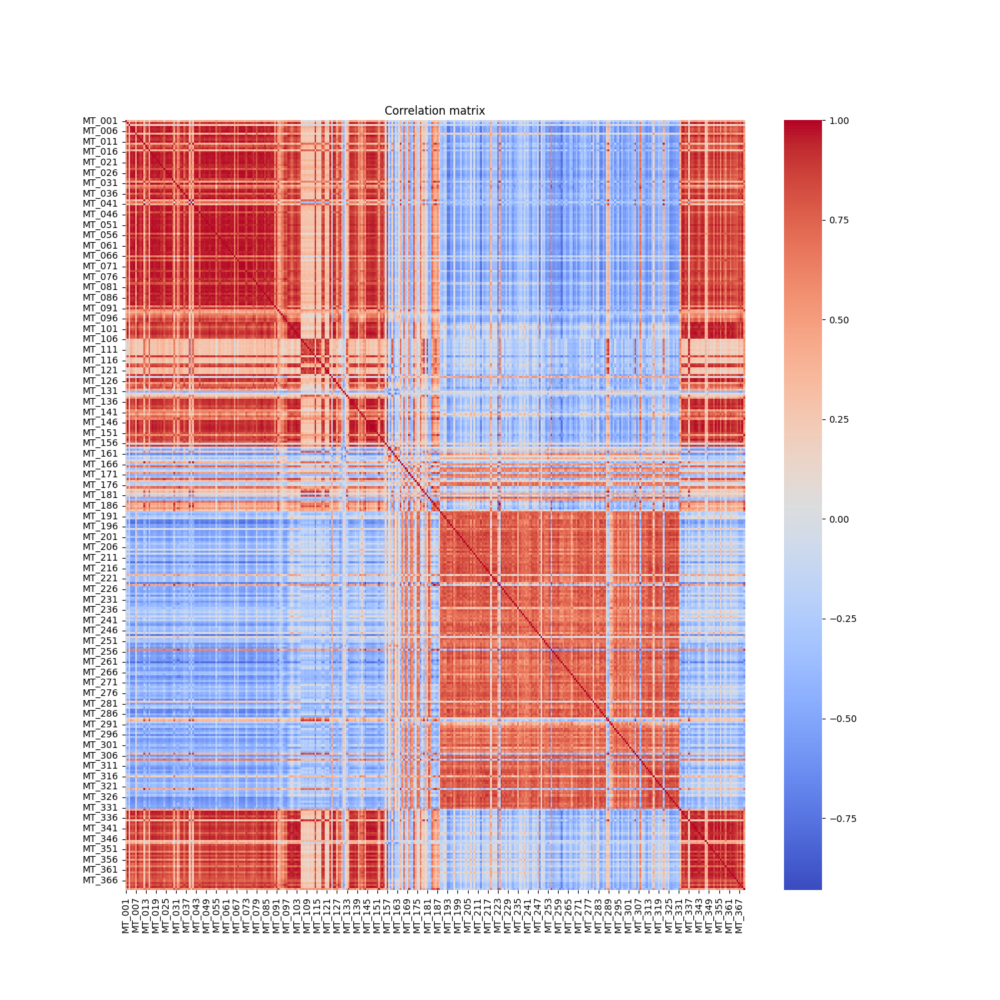

In [38]:
import seaborn as sns
fig, ax1 = plt.subplots(ncols=1, figsize=(15,15))
sns.heatmap(corr_mat_a, ax = ax1, cmap='coolwarm');
ax1.title.set_text('Correlation matrix')
plt.show()

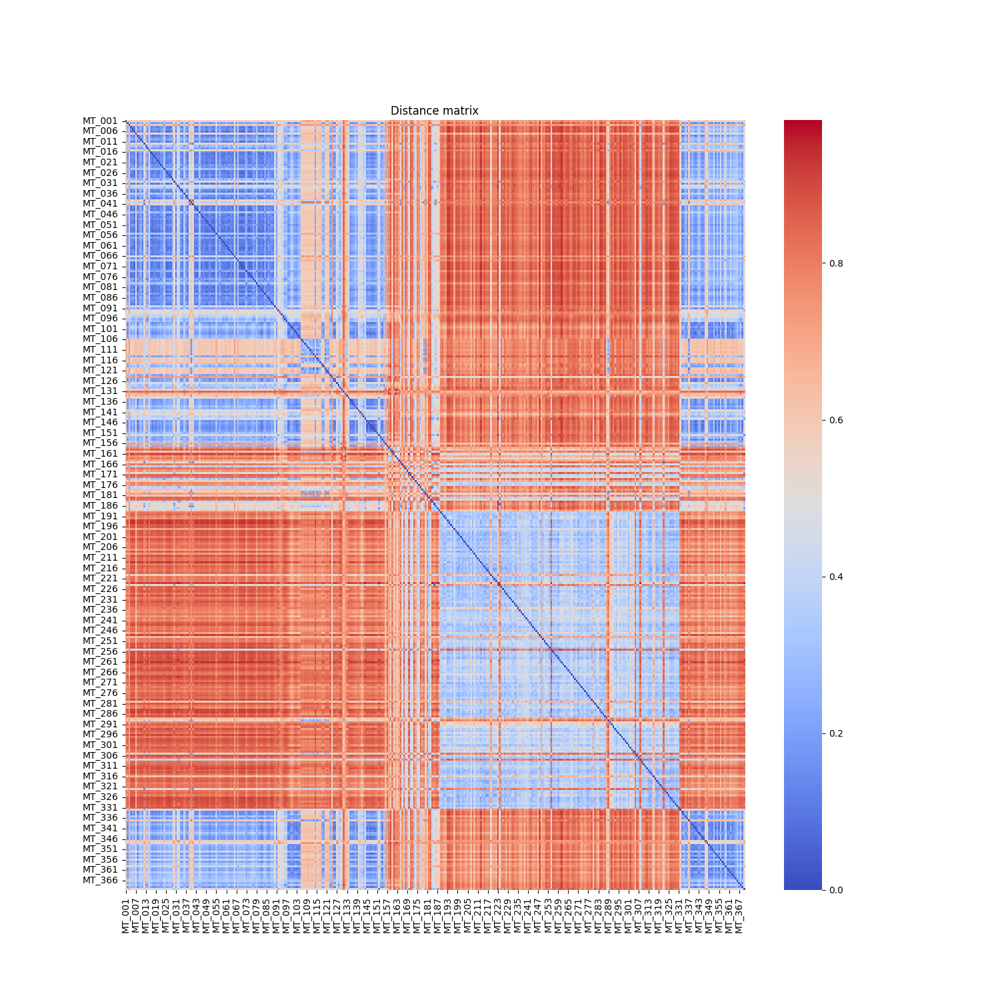

In [39]:
fig, ax2= plt.subplots(ncols=1, figsize=(15,15))
sns.heatmap(dist_a, ax = ax2, cmap='coolwarm');
ax2.title.set_text('Distance matrix')
plt.show()

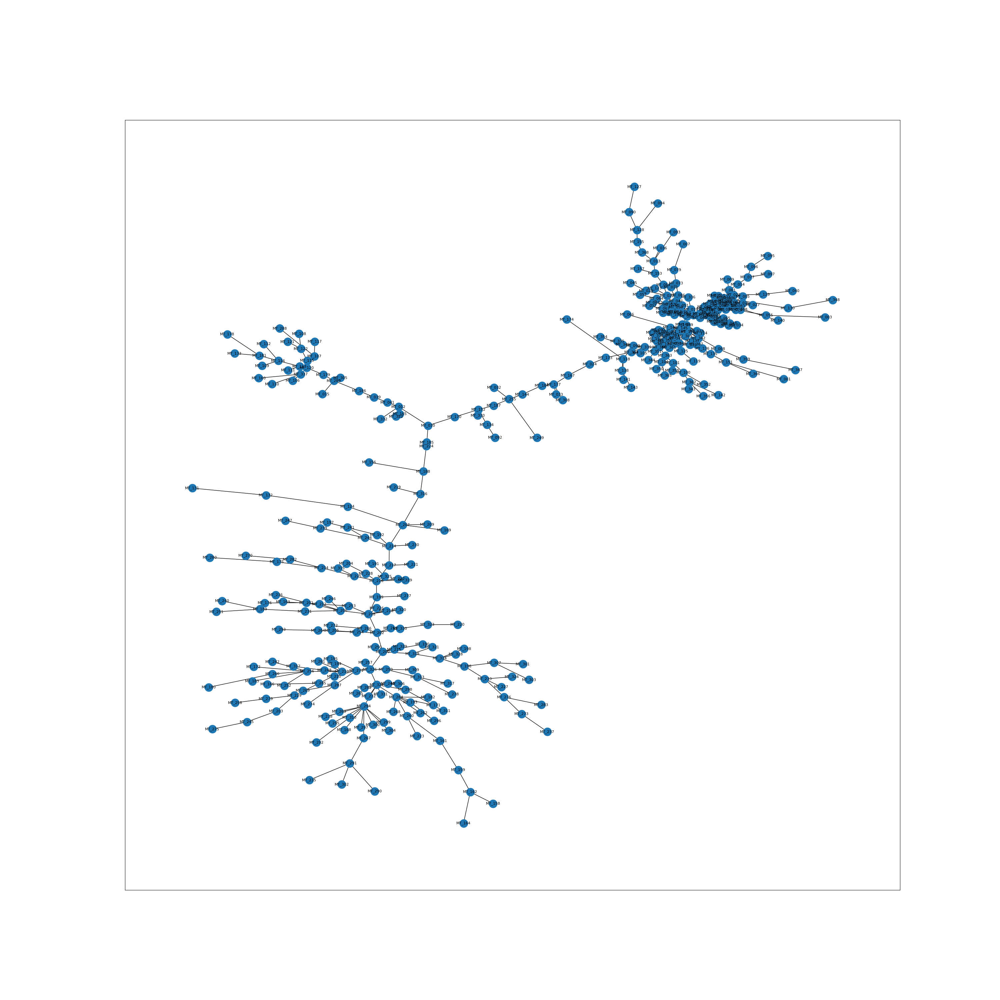

In [40]:
import networkx as nx
G_a = nx.Graph(dist_a.to_numpy())
labels = dist_a.columns.values
G_a = nx.relabel_nodes(G_a, dict(zip(range(len(labels)),labels)))
T_a = nx.minimum_spanning_tree(G_a)

fig = plt.figure(figsize = (30,30))
nx.draw_networkx(T_a,
                 with_labels=True,
                 font_size = 8,
                 cmap = plt.cm.coolwarm,
                 pos = nx.kamada_kawai_layout(T_a),vmin = 0, vmax=1
                 )
plt.show()

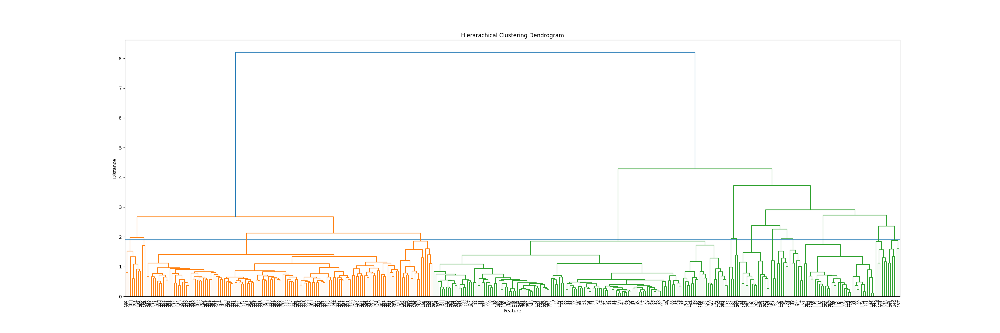

In [41]:
import scipy.cluster.hierarchy as sch
link_a = sch.linkage(dist_a,'average')
fig = plt.figure(figsize=(30,10))
plt.title('Hierarachical Clustering Dendrogram')
plt.xlabel('Feature')
plt.ylabel('Distance')
plt.hlines(1.9,0, 19800)
dn_a = sch.dendrogram(link_a, leaf_rotation = 90., leaf_font_size=8.)
plt.show()

In [42]:
from scipy.cluster.hierarchy import fcluster
max_d = 1.9
clusters_a = fcluster(link_a, t=max_d, criterion='distance')

In [43]:
df_clust_a= pd.DataFrame({'Cluster':clusters_a, 'Feature':a.columns.values.astype('str')})
df_clust_a.groupby('Cluster').count()

,Feature
Cluster,
1,8
2,2
3,121
4,16
5,141
6,3
7,2
8,15
9,3


### visually verify this clustering works better than other ones

In [44]:
df_clust_a[(df_clust_a.Feature == 'MT_223')]

,Cluster,Feature
222,1,MT_223


In [45]:
df_clust_a[(df_clust_a.Cluster == 1)]

,Cluster,Feature
160,1,MT_161
182,1,MT_183
222,1,MT_223
234,1,MT_235
266,1,MT_267
289,1,MT_290
290,1,MT_291
301,1,MT_302


In [46]:
a.MT_223.plot()

<Axes: title={'center': 'Hierarachical Clustering Dendrogram'}, xlabel='Feature', ylabel='Distance'>

In [47]:
a.MT_183.plot()

<Axes: title={'center': 'Hierarachical Clustering Dendrogram'}, xlabel='Feature', ylabel='Distance'>

In [48]:
df_clust_a[(df_clust_a.Cluster == 2)]

,Cluster,Feature
130,2,MT_131
158,2,MT_159


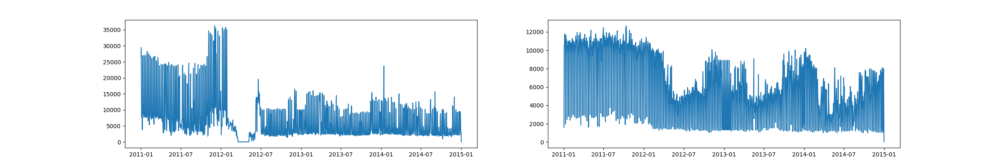

In [49]:
fig,(ax1, ax2) = plt.subplots(ncols=2, figsize=(24,4))
ax1.plot(a.MT_131)
ax2.plot(a.MT_159)

In [50]:
df_clust_a[(df_clust_a.Cluster == 7)]

,Cluster,Feature
155,7,MT_156
248,7,MT_249


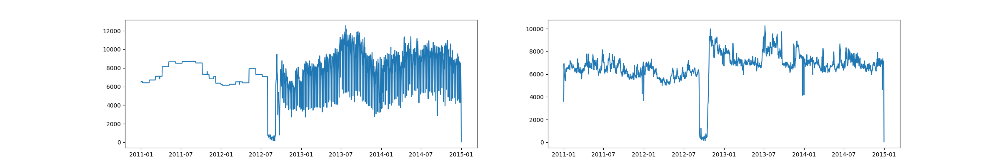

In [51]:
fig,(ax1, ax2) = plt.subplots(ncols=2, figsize=(24,4))
ax1.plot(a.MT_156)
ax2.plot(a.MT_249)

In [52]:
df_clust_a[(df_clust_a.Cluster == 6)]

,Cluster,Feature
157,6,MT_158
161,6,MT_162
163,6,MT_164


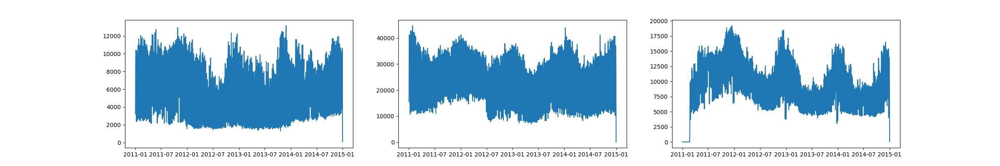

In [53]:
fig,(ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(24,4))
ax1.plot(a.MT_158)
ax2.plot(a.MT_162)
ax3.plot(a.MT_164)

In [54]:
df_clust_a[(df_clust_a.Cluster == 9)]

,Cluster,Feature
141,9,MT_142
351,9,MT_352
355,9,MT_356


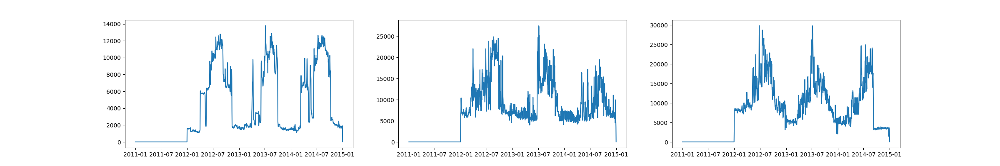

In [55]:
fig,(ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(24,4))
ax1.plot(a.MT_142)
ax2.plot(a.MT_352)
ax3.plot(a.MT_356)

Text(0.5, 1.0, 'Data Segmentation')

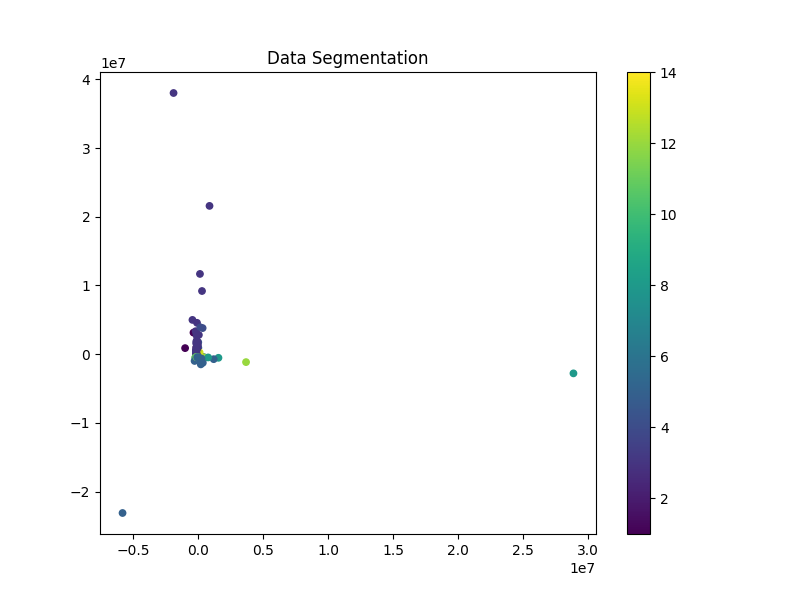

In [66]:
fig, ax = plt.subplots(figsize=(8, 6))
scatter=ax.scatter(z,y,c=PCA_ds["Clusters"],s=21)
plt.colorbar(scatter)
plt.title('Data Segmentation')

### cluster data visualization

In [57]:
c = df_clust_a.groupby('Cluster').count()

In [58]:
c.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14 entries, 1 to 14
Data columns (total 1 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   Feature  14 non-null     int64
dtypes: int64(1)
memory usage: 224.0 bytes


Text(0.5, 1.0, 'Cluster of Data')

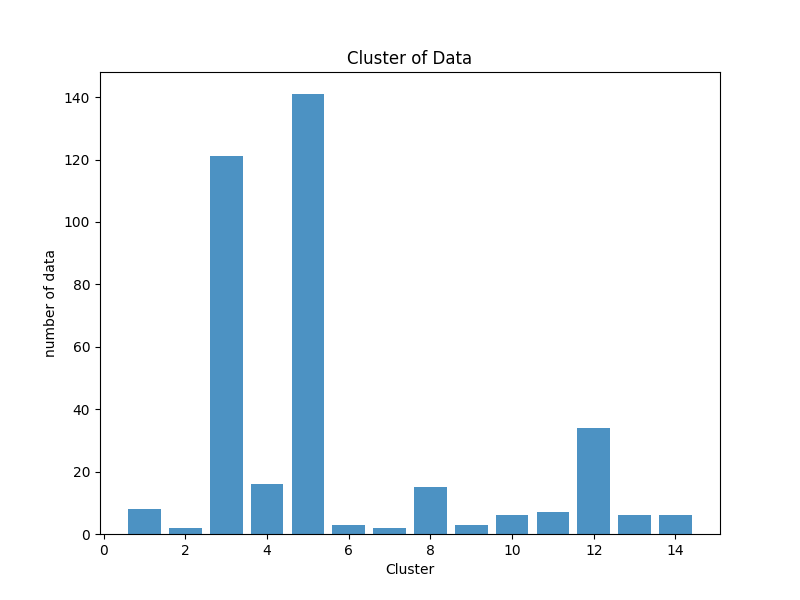

In [59]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.bar(c.index,c['Feature'],align='center',alpha=0.8)
plt.xlabel('Cluster')
plt.ylabel('number of data')
plt.title('Cluster of Data')

In [49]:
d = a.T

In [50]:
d

,2011-01-01,2011-01-02,2011-01-03,2011-01-04,2011-01-05,2011-01-06,2011-01-07,2011-01-08,2011-01-09,2011-01-10,...,2014-12-23,2014-12-24,2014-12-25,2014-12-26,2014-12-27,2014-12-28,2014-12-29,2014-12-30,2014-12-31,2015-01-01
MT_001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.500000e+02,170.050761,151.015228,2.131980e+02,2.119289e+02,2.271574e+02,2.487310e+02,2.322335e+02,2.296954e+02,2.538071
MT_002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.176387e+03,2259.601707,2177.809388,2.173542e+03,2.145804e+03,2.131579e+03,2.212660e+03,2.205548e+03,2.273115e+03,19.914651
MT_003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.650738e+02,166.811468,1.737619,1.615986e+02,1.772372e+02,1.511729e+02,1.607298e+02,1.650738e+02,1.668115e+02,1.737619
MT_004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.446138e+04,13871.951220,12922.764228,1.387805e+04,1.494512e+04,1.432724e+04,1.406707e+04,1.429065e+04,1.400610e+04,178.861789
MT_005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,7.503659e+03,6798.780488,6773.170732,6.979268e+03,7.368293e+03,6.776829e+03,7.198780e+03,7.189024e+03,7.023171e+03,84.146341
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT_366,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,5.915740e+02,537.156232,539.496782,1.084845e+03,6.980690e+02,5.523698e+02,1.153891e+03,8.923347e+02,5.301346e+02,4.095963
MT_367,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,5.862072e+04,54141.352063,46725.197542,5.390342e+04,5.348112e+04,4.591484e+04,5.392888e+04,5.633450e+04,5.025988e+04,628.621598
MT_368,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.621536e+04,13050.083472,4938.230384,1.249750e+04,7.823038e+03,4.405676e+03,1.291486e+04,1.599666e+04,1.324541e+04,131.886477
MT_369,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,7.891935e+04,75068.181818,67715.542522,7.672287e+04,7.096848e+04,6.613563e+04,7.388270e+04,7.395015e+04,7.041642e+04,673.020528


In [62]:
d.columns

DatetimeIndex(['2011-01-01', '2011-01-02', '2011-01-03', '2011-01-04',
               '2011-01-05', '2011-01-06', '2011-01-07', '2011-01-08',
               '2011-01-09', '2011-01-10',
               ...
               '2014-12-23', '2014-12-24', '2014-12-25', '2014-12-26',
               '2014-12-27', '2014-12-28', '2014-12-29', '2014-12-30',
               '2014-12-31', '2015-01-01'],
              dtype='datetime64[ns]', length=1462, freq='D')

In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
pca.fit(d)
PCA_ds = pd.DataFrame(pca.transform(d), columns=(["col1","col2", "col3"]))
PCA_ds.describe()
x =PCA_ds["col1"]
y =PCA_ds["col2"]
z =PCA_ds["col3"]
#To plot
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111, projection="3d")
ax.scatter(x,y,z, c="maroon", marker="o" )
ax.set_title("A 3D Projection Of Data In The Reduced Dimension")
plt.show()

In [ ]:
PCA_ds["Clusters"] = df_clust_a.Cluster
fig = plt.figure(figsize=(20,10))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=70, c=PCA_ds["Clusters"], marker='o' )
ax.set_title("The Plot Of The Clusters")
plt.show()

In [65]:
PCA_ds

,col1,col2,col3,Clusters
0,-1.934258e+06,-4.481408e+05,-1.191298e+05,14
1,-1.865203e+06,-4.509376e+05,-1.119108e+05,5
2,-1.940697e+06,-4.449005e+05,-1.253144e+05,14
3,-1.628440e+06,-4.419416e+05,-6.124104e+04,5
4,-1.807054e+06,-4.416710e+05,-9.656403e+04,5
...,...,...,...,...
365,-1.912176e+06,-4.490170e+05,-1.180220e+05,11
366,-2.084722e+05,-5.076854e+05,1.993356e+04,5
367,-1.570881e+06,-4.496644e+05,-6.586009e+04,5
368,6.303915e+05,-5.515166e+05,5.010561e+04,5


### Descriptive text about each cluster

In [44]:
df_clust_a.Cluster

0      14
1       5
2      14
3       5
4       5
       ..
365    11
366     5
367     5
368     5
369     8
Name: Cluster, Length: 370, dtype: int32

In [45]:
df_clust_a.set_index(df_clust_a.Feature,inplace = True)

In [46]:
df_clust_a.drop(columns = ['Feature'], inplace = True)

In [51]:
d = pd.concat([d, df_clust_a], axis=1)

In [52]:
d

,2011-01-01 00:00:00,2011-01-02 00:00:00,2011-01-03 00:00:00,2011-01-04 00:00:00,2011-01-05 00:00:00,2011-01-06 00:00:00,2011-01-07 00:00:00,2011-01-08 00:00:00,2011-01-09 00:00:00,2011-01-10 00:00:00,...,2014-12-24 00:00:00,2014-12-25 00:00:00,2014-12-26 00:00:00,2014-12-27 00:00:00,2014-12-28 00:00:00,2014-12-29 00:00:00,2014-12-30 00:00:00,2014-12-31 00:00:00,2015-01-01 00:00:00,Cluster
MT_001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,170.050761,151.015228,2.131980e+02,2.119289e+02,2.271574e+02,2.487310e+02,2.322335e+02,2.296954e+02,2.538071,14
MT_002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2259.601707,2177.809388,2.173542e+03,2.145804e+03,2.131579e+03,2.212660e+03,2.205548e+03,2.273115e+03,19.914651,5
MT_003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,166.811468,1.737619,1.615986e+02,1.772372e+02,1.511729e+02,1.607298e+02,1.650738e+02,1.668115e+02,1.737619,14
MT_004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,13871.951220,12922.764228,1.387805e+04,1.494512e+04,1.432724e+04,1.406707e+04,1.429065e+04,1.400610e+04,178.861789,5
MT_005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6798.780488,6773.170732,6.979268e+03,7.368293e+03,6.776829e+03,7.198780e+03,7.189024e+03,7.023171e+03,84.146341,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT_366,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,537.156232,539.496782,1.084845e+03,6.980690e+02,5.523698e+02,1.153891e+03,8.923347e+02,5.301346e+02,4.095963,11
MT_367,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,54141.352063,46725.197542,5.390342e+04,5.348112e+04,4.591484e+04,5.392888e+04,5.633450e+04,5.025988e+04,628.621598,5
MT_368,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,13050.083472,4938.230384,1.249750e+04,7.823038e+03,4.405676e+03,1.291486e+04,1.599666e+04,1.324541e+04,131.886477,5
MT_369,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,75068.181818,67715.542522,7.672287e+04,7.096848e+04,6.613563e+04,7.388270e+04,7.395015e+04,7.041642e+04,673.020528,5


In [53]:
cluster = d.groupby('Cluster').mean()

In [54]:
cluster

,2011-01-01,2011-01-02,2011-01-03,2011-01-04,2011-01-05,2011-01-06,2011-01-07,2011-01-08,2011-01-09,2011-01-10,...,2014-12-23,2014-12-24,2014-12-25,2014-12-26,2014-12-27,2014-12-28,2014-12-29,2014-12-30,2014-12-31,2015-01-01
Cluster,,,,,,,,,,,,,,,,,,,,,
1,44477.134629,57871.002017,60482.968064,61772.433396,61266.570611,61639.867222,61812.703924,61443.703797,58208.160308,59364.136086,...,43221.767834,40935.357746,28271.096726,41336.311958,41676.324490,39507.351438,40898.133923,41543.813208,40302.788409,272.268290
2,14003.369253,15521.992337,9429.944923,9252.559866,9463.273467,9676.537356,7538.079502,17814.686303,14446.070402,9115.991379,...,4878.283046,5663.884100,5409.193008,5554.212165,3722.837644,5168.000479,6348.987069,5123.472222,4215.426245,25.328065
3,47543.231498,78989.749721,79430.719978,80744.999315,81420.188988,82005.152766,81192.202278,81084.297196,78406.099286,79379.256700,...,67378.643426,61820.969008,29988.423391,64645.366217,65150.976432,63634.498978,63849.843410,64818.306849,59558.093535,361.040487
4,39389.403943,60251.493111,61476.724574,64210.288529,62791.501885,62846.369585,64541.264459,63393.034555,57997.325863,64377.896018,...,57971.117861,54020.976809,32877.090735,56029.024524,55617.201133,54649.078989,55597.790855,55050.753255,50721.418189,300.386189
5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,54495.403092,48478.093781,34856.741912,52126.904491,52582.971736,52689.035967,52663.844200,51458.706356,46823.093322,415.882715
6,6326.966479,6298.691631,15174.066695,17206.472871,16723.909272,15206.244313,15081.011416,11398.451745,4335.483996,15664.097289,...,20852.931772,21484.938360,6429.447716,20404.424935,9077.387688,10892.474484,18584.851580,20471.627963,15030.968220,69.515368
7,5052.960764,6742.660662,6451.734482,6292.473162,6280.315424,6126.844601,6005.785662,5964.829525,5912.026682,6350.592600,...,7439.313332,7786.592197,4462.868151,7952.901500,6793.866045,5588.933796,7828.647068,7277.430235,5948.605739,34.005355
8,68.257519,69.152374,239.622173,236.639324,221.377082,216.853095,217.449664,85.756898,53.542133,232.314193,...,123591.032177,65076.721071,54365.565950,97001.955099,112026.018857,119455.856025,137831.910324,141922.797917,107691.766993,598.401843
9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,4146.497456,3659.257622,2559.464857,4087.839598,4839.091985,5170.110542,3568.366356,3404.132283,2717.628738,20.281607


In [55]:
cluster = cluster.T

<Axes: title={'center': 'clusters data visualization across time'}>

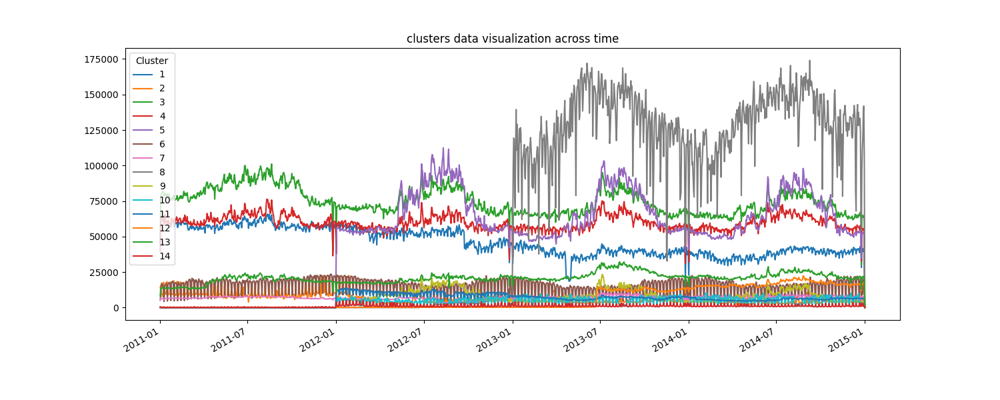

In [56]:
cluster.plot(figsize=(15,6),title = 'clusters data visualization across time')

<Axes: >

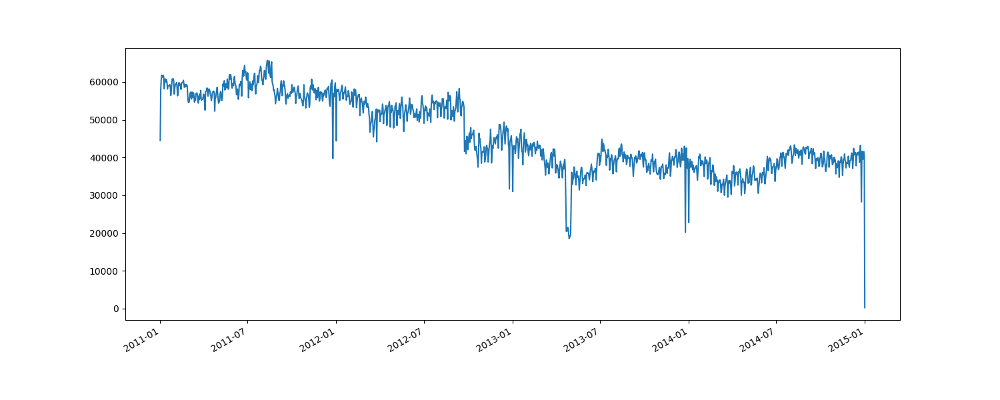

In [70]:
plt.close()
cluster[1].plot(figsize = (15,6))

<Axes: >

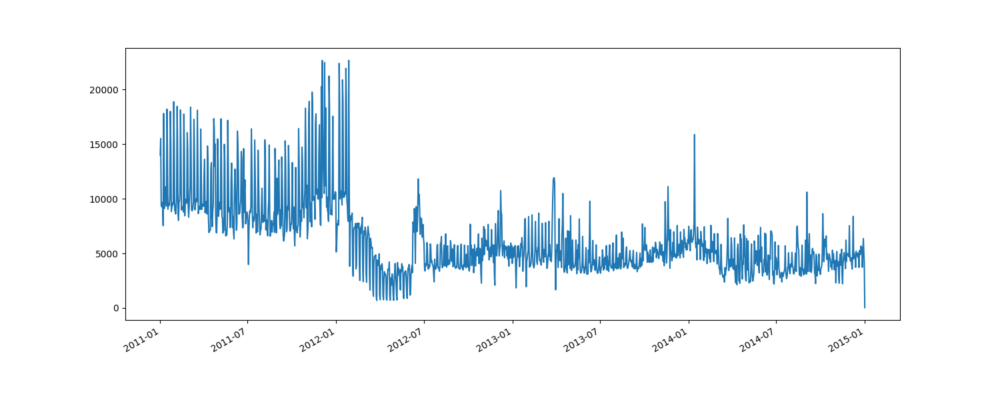

In [69]:
plt.close()
cluster[2].plot(figsize = (15,6))

<Axes: >

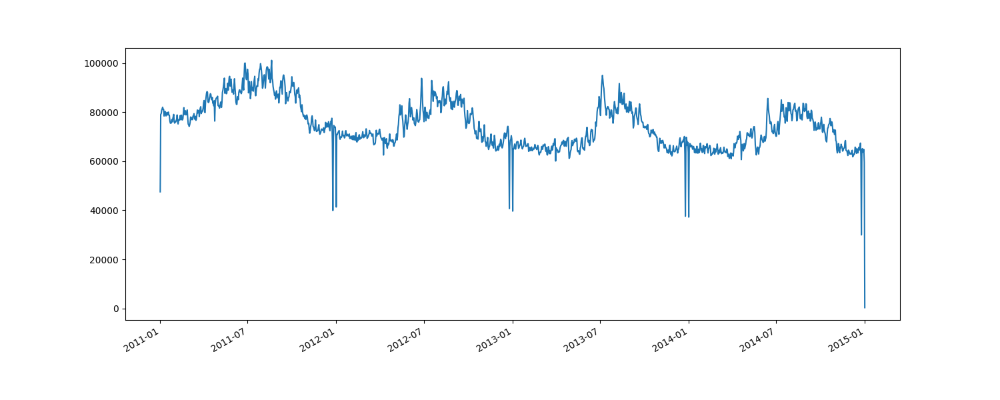

In [91]:
plt.close()
cluster[3].plot(figsize = (15,6))

<Axes: >

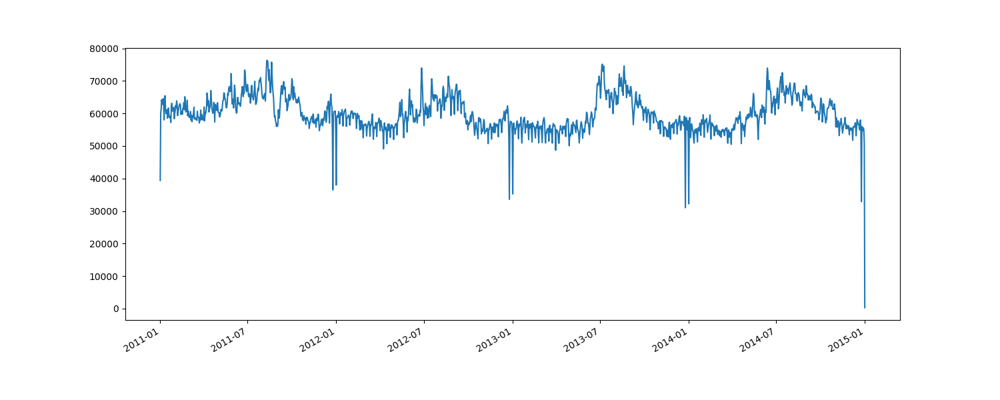

In [90]:
plt.close()
cluster[4].plot(figsize = (15,6))

<Axes: >

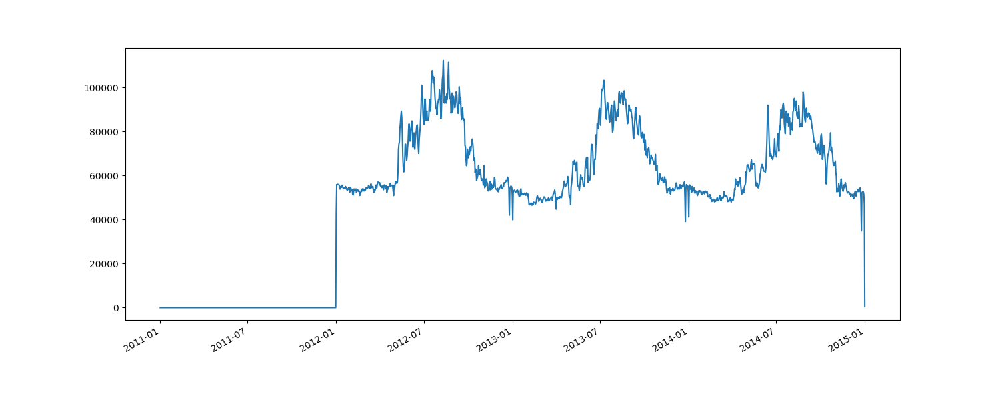

In [89]:
plt.close()
cluster[5].plot(figsize = (15,6))

<Axes: >

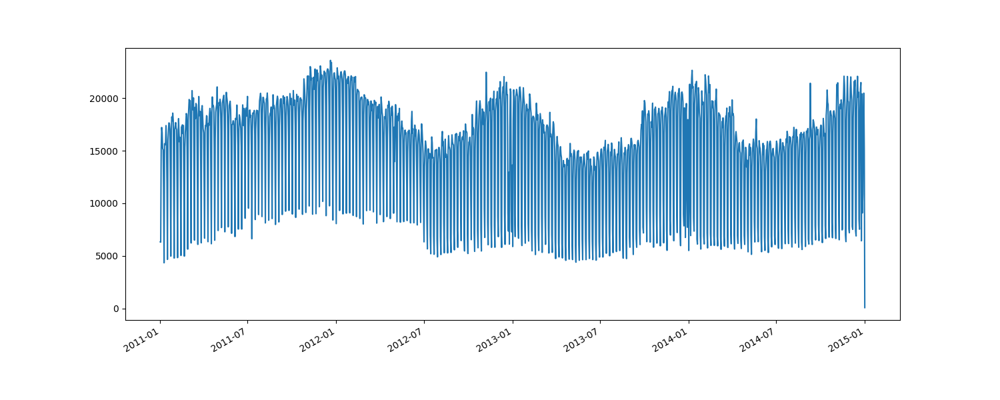

In [88]:
plt.close()
cluster[6].plot(figsize = (15,6))

<Axes: >

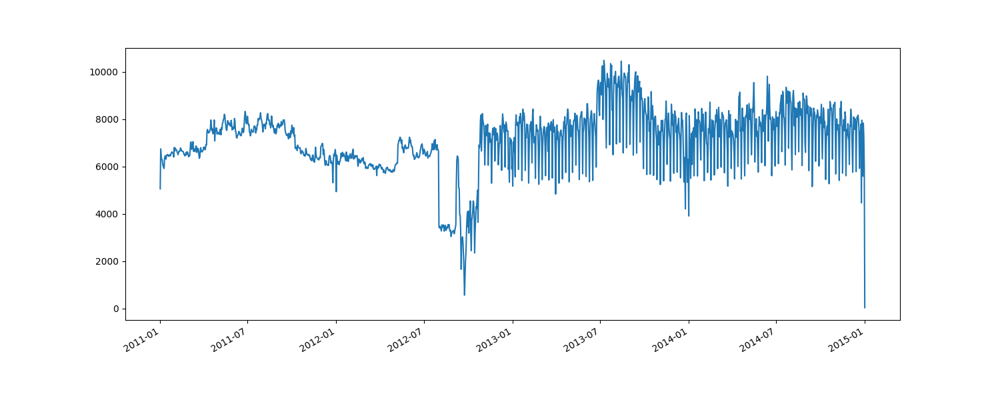

In [87]:
plt.close()
cluster[7].plot(figsize = (15,6))

<Axes: >

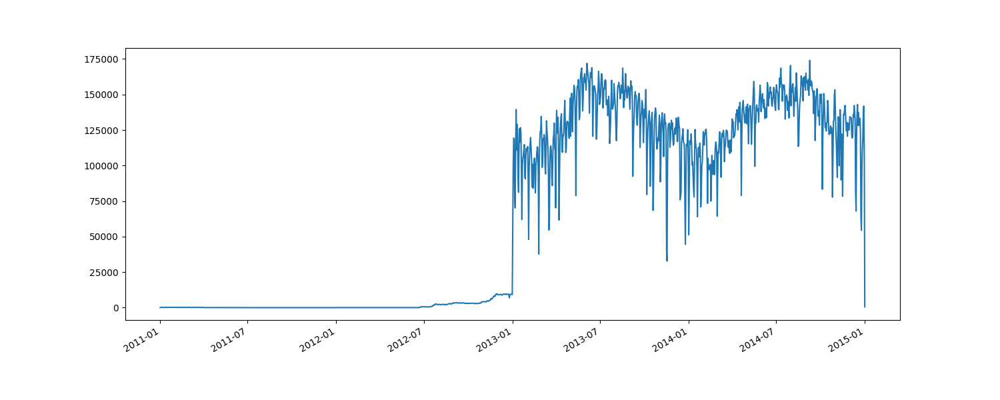

In [86]:
plt.close()
cluster[8].plot(figsize = (15,6))

<Axes: >

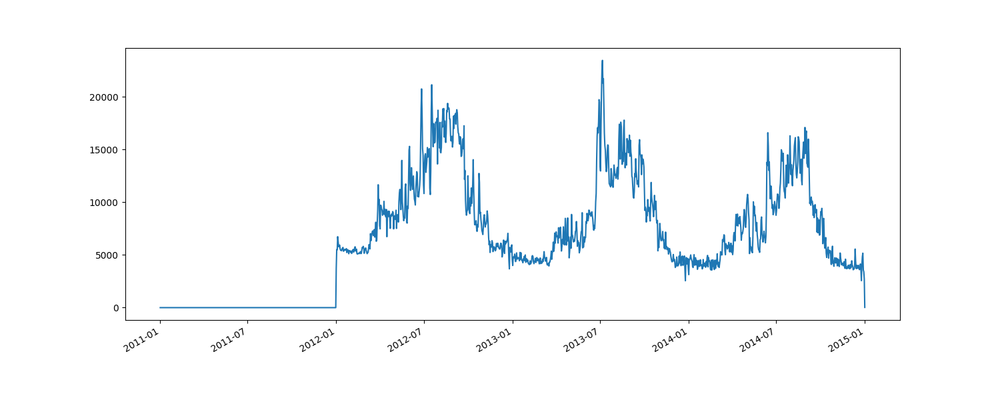

In [85]:
plt.close()
cluster[9].plot(figsize = (15,6))

<Axes: >

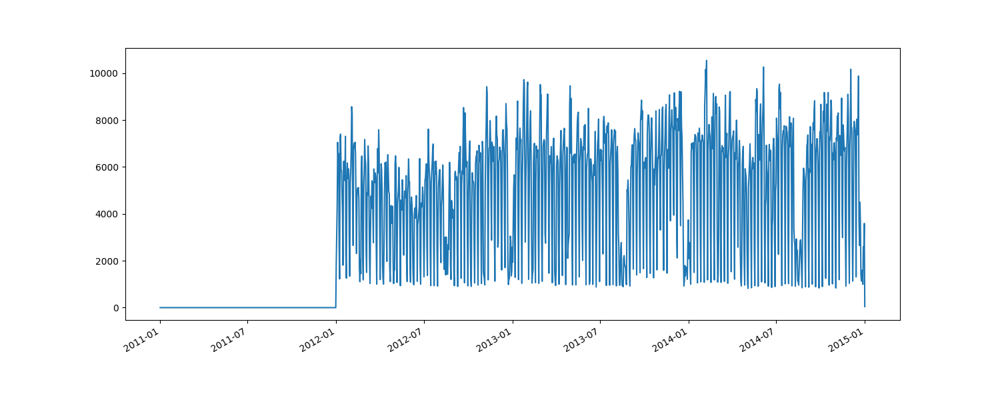

In [84]:
plt.close()
cluster[10].plot(figsize = (15,6))

<Axes: >

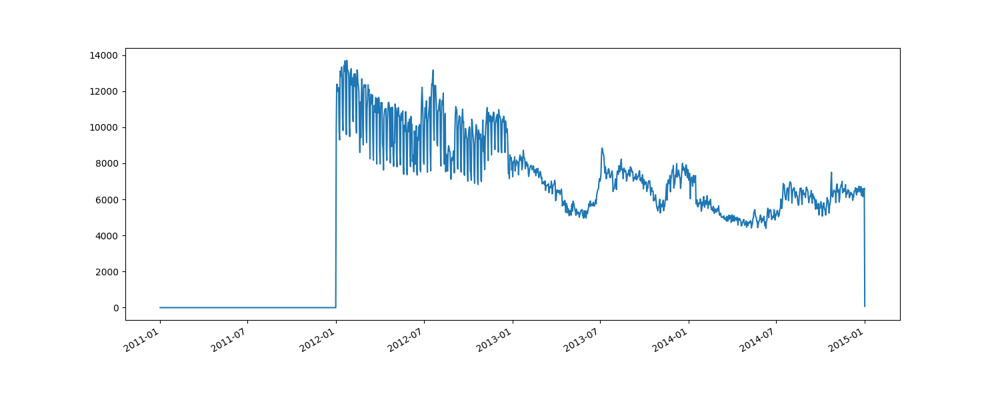

In [79]:
plt.close()
cluster[11].plot(figsize = (15,6))

<Axes: >

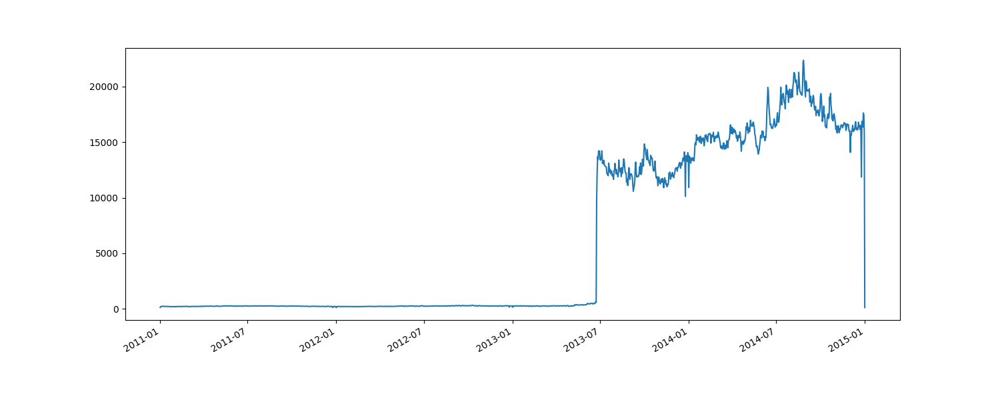

In [83]:
plt.close()
cluster[12].plot(figsize = (15,6))

<Axes: >

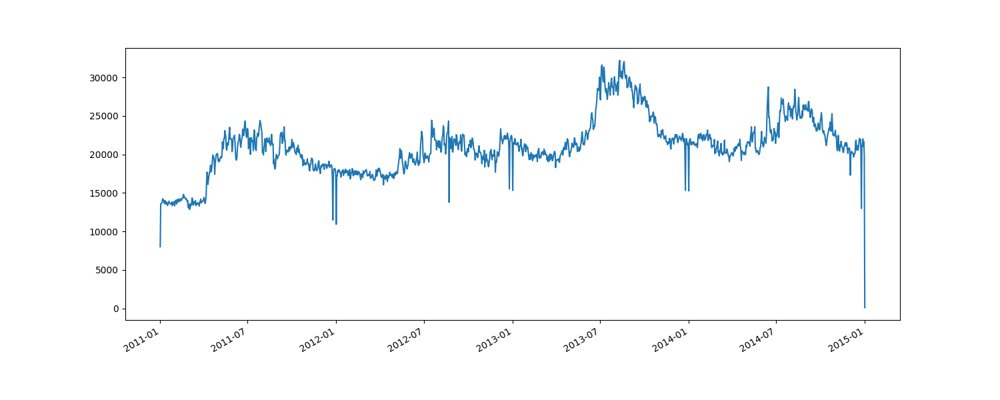

In [92]:
plt.close()
cluster[13].plot(figsize = (15,6))

<Axes: >

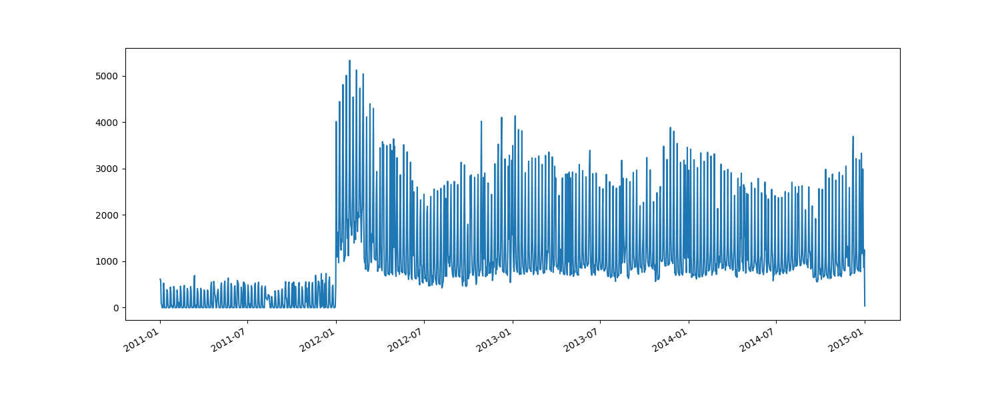

In [82]:
plt.close()
cluster[14].plot(figsize = (15,6))

### save data

In [ ]:
file_name = "/content/drive/My Drive/IEOR4574:Project_2/electricity_data.xlsx"
cluster.to_excel(file_name)

In [ ]:
d.to_excel("/content/drive/My Drive/IEOR4574:Project_2/electricity_og_data.xlsx")

## *daily aggregation data + standardization + outliers erasion*


In [ ]:
b = (a - a.mean())/(a.std())

In [ ]:
outl_thresh = 0.999
outliers_mask =(b > b.quantile(outl_thresh)).any(axis = 1)
b = b[~outliers_mask]

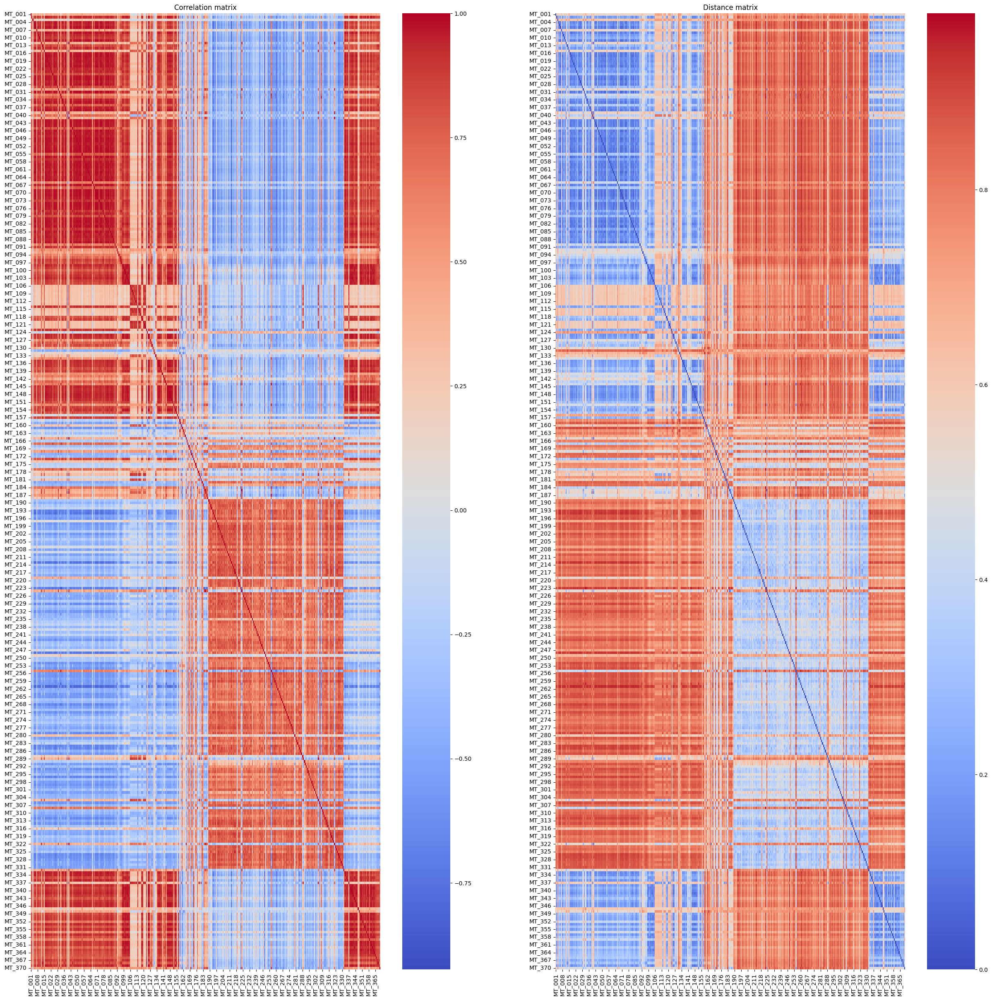

In [ ]:
corr_mat_b = b.corr(method ='pearson')
dist_b = np.sqrt(0.5*(1-corr_mat_b))
fig,(ax1, ax2) = plt.subplots(ncols=2, figsize=(30,30))
sns.heatmap(corr_mat_b, ax = ax1, cmap='coolwarm');
sns.heatmap(dist_b, ax = ax2, cmap='coolwarm');
ax1.title.set_text('Correlation matrix')
ax2.title.set_text('Distance matrix')
plt.show()

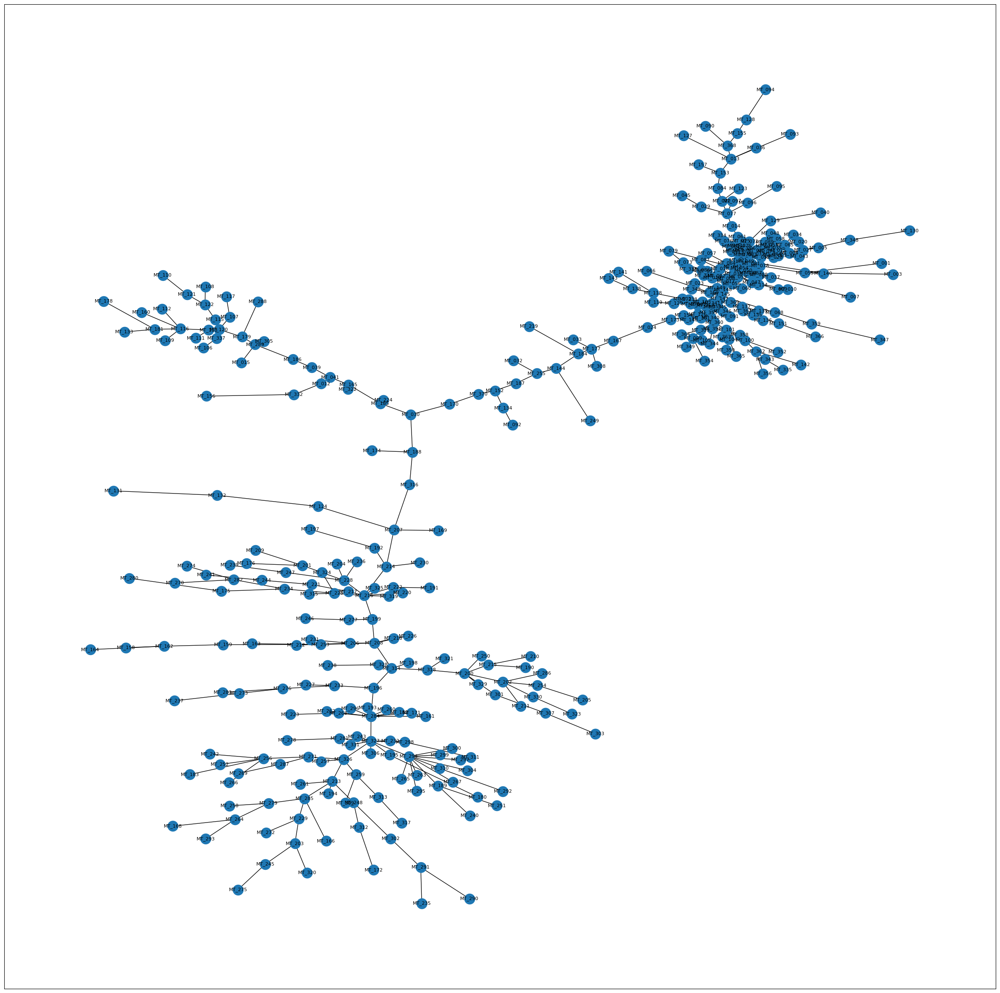

In [ ]:
G_b = nx.Graph(dist_b.to_numpy())
labels = dist_b.columns.values
G_b = nx.relabel_nodes(G_b, dict(zip(range(len(labels)),labels)))
T_b = nx.minimum_spanning_tree(G_b)

fig = plt.figure(figsize = (30,30))
nx.draw_networkx(T_b,
                 with_labels=True,
                 font_size = 8,
                 cmap = plt.cm.coolwarm,
                 pos = nx.kamada_kawai_layout(T_b),vmin = 0, vmax=1
                 )
plt.show()

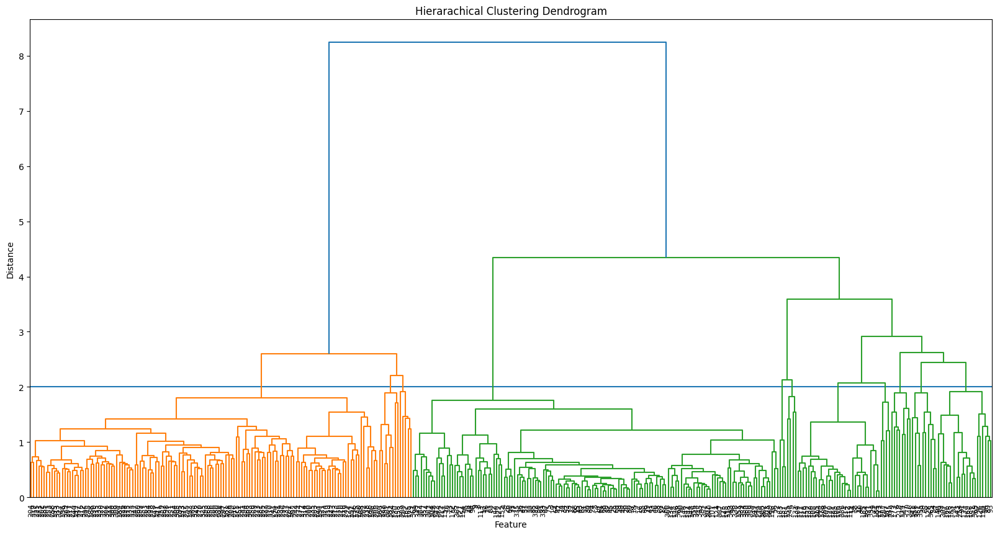

In [ ]:
link_b = sch.linkage(dist_b,'average')
fig = plt.figure(figsize=(20,10))
plt.title('Hierarachical Clustering Dendrogram')
plt.xlabel('Feature')
plt.ylabel('Distance')
plt.hlines(2,0, 19800)
dn = sch.dendrogram(link_b, leaf_rotation = 90., leaf_font_size=8.)
plt.show()

In [ ]:
max_d = 2
clusters_b = fcluster(link_b, t=max_d, criterion='distance')

In [ ]:
df_clust_b = pd.DataFrame({'Cluster':clusters, 'Feature':b.columns.values.astype('str')})
df_clust_b.groupby('Cluster').count()

,Feature
Cluster,
1,111
2,45
3,50
4,7
5,2
6,6
7,7
8,141
9,1


In [ ]:
df_clust_b[(df_clust_b.Cluster == 9)]

,Cluster,Feature
222,9,MT_223


In [ ]:
df_clust_b[(df_clust_b.Cluster == 5)]

,Cluster,Feature
130,5,MT_131
160,5,MT_161


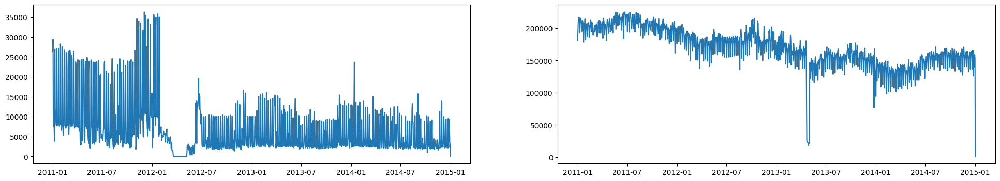

In [ ]:
fig,(ax1, ax2) = plt.subplots(ncols=2, figsize=(24,4))
ax1.plot(a.MT_131)
ax2.plot(a.MT_161)

## test of agglomerativeClustering imported sklearn.cluster(to be continued)

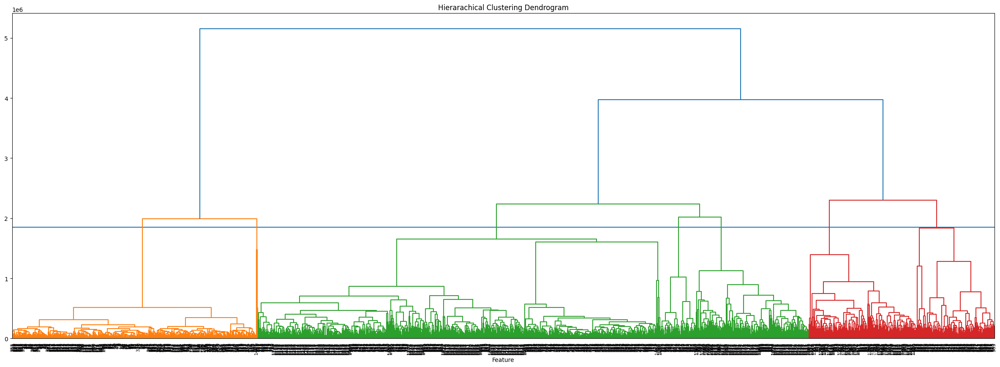

In [ ]:
link = sch.linkage(a,'average')
fig = plt.figure(figsize=(30,10))
plt.title('Hierarachical Clustering Dendrogram')
plt.xlabel('Feature')
# plt.ylabel('Distance')
plt.hlines(1.85*1000000,0, 19800)
dn = sch.dendrogram(link, leaf_rotation = 90., leaf_font_size=8.)
plt.show()

In [ ]:
from sklearn.cluster import AgglomerativeClustering
AC = AgglomerativeClustering(n_clusters=7, linkage = 'average')
yhat_AC = AC.fit_predict(a)

In [ ]:
yhat_AC

array([2, 6, 6, ..., 1, 1, 2])

In [ ]:
len(yhat_AC)

1462

In [ ]:
a.index[a.values == False].tolist()

['MT_124',
 'MT_156',
 'MT_158',
 'MT_159',
 'MT_161',
 'MT_162',
 'MT_163',
 'MT_164',
 'MT_166',
 'MT_168',
 'MT_169',
 'MT_171',
 'MT_172',
 'MT_174',
 'MT_175',
 'MT_176',
 'MT_180',
 'MT_182',
 'MT_183',
 'MT_187',
 'MT_188',
 'MT_189',
 'MT_190',
 'MT_191',
 'MT_192',
 'MT_193',
 'MT_194',
 'MT_195',
 'MT_196',
 'MT_197',
 'MT_198',
 'MT_199',
 'MT_200',
 'MT_201',
 'MT_202',
 'MT_203',
 'MT_204',
 'MT_205',
 'MT_206',
 'MT_207',
 'MT_208',
 'MT_209',
 'MT_210',
 'MT_211',
 'MT_212',
 'MT_213',
 'MT_214',
 'MT_215',
 'MT_216',
 'MT_217',
 'MT_218',
 'MT_219',
 'MT_220',
 'MT_221',
 'MT_222',
 'MT_223',
 'MT_225',
 'MT_226',
 'MT_227',
 'MT_228',
 'MT_229',
 'MT_230',
 'MT_231',
 'MT_232',
 'MT_233',
 'MT_234',
 'MT_235',
 'MT_236',
 'MT_237',
 'MT_238',
 'MT_239',
 'MT_240',
 'MT_241',
 'MT_242',
 'MT_243',
 'MT_244',
 'MT_245',
 'MT_246',
 'MT_247',
 'MT_248',
 'MT_249',
 'MT_250',
 'MT_251',
 'MT_252',
 'MT_253',
 'MT_254',
 'MT_256',
 'MT_257',
 'MT_258',
 'MT_259',
 'MT_260',

In [ ]:
a = data.resample('D').sum()

In [ ]:
a

,MT_001,MT_002,MT_003,MT_004,MT_005,MT_006,MT_007,MT_008,MT_009,MT_010,...,MT_361,MT_362,MT_363,MT_364,MT_365,MT_366,MT_367,MT_368,MT_369,MT_370
2011-01-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-03,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
2011-01-05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-28,227.157360,2131.578947,151.172893,14327.235772,6776.829268,20122.023810,429.621255,25255.892256,5118.881119,4794.623656,...,28815.132049,3272100.0,220721.518987,257477.272727,8169.491525,552.369807,45914.837577,4405.676127,66135.630499,1.553189e+06
2014-12-29,248.730964,2212.660028,160.729800,14067.073171,7198.780488,22824.404762,550.593556,30286.195286,6697.552448,6337.634409,...,28825.124911,3109100.0,206852.320675,269090.909091,8438.070404,1153.891164,53928.884987,12914.858097,73882.697947,1.806486e+06
2014-12-30,232.233503,2205.547653,165.073849,14290.650407,7189.024390,23880.952381,586.772188,30909.090909,6487.762238,6489.247312,...,28488.222698,2904300.0,204126.582278,263613.636364,10615.384615,892.334699,56334.503951,15996.661102,73950.146628,1.867568e+06
2014-12-31,229.695431,2273.115220,166.811468,14006.097561,7023.170732,23511.904762,690.785755,28700.336700,6211.538462,5034.408602,...,26970.735189,2748800.0,162556.962025,215886.363636,7415.906128,530.134582,50259.877085,13245.409015,70416.422287,1.365892e+06
